# Analysis of single cell Flex data
ENVIRONMENT: celiac_env3

## Imports

In [1]:
import scanpy as sc
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import matplotlib as mpl
import plotly.express as px
from adjustText import adjust_text
from tqdm import tqdm
import gseapy as gp
import os
import warnings
from datetime import datetime
from scipy.stats import zscore
import scipy
from sklearn.decomposition import PCA
import math
from scipy.sparse import issparse
from statsmodels.stats.multitest import multipletests
from scipy.stats import ranksums
import dill
import session_info2
from matplotlib.patheffects import withStroke


np.random.seed(1)
# import py_funcs

warnings.filterwarnings("ignore")

mpl.rcParams['pdf.fonttype'] = 42 # to edit text in Illustrator
LOAD_ARIAL = True
if LOAD_ARIAL:
    # set the default font to Arial
    from matplotlib.font_manager import FontProperties, fontManager
    from matplotlib import rcParams
    # Path to Arial font
    arial_path = '/mnt/x/common/joint_projects/spatial_celiac/utils/Arial.ttf'

    # Define font properties with the specific path
    arial_font = FontProperties(fname=arial_path)
    fontManager.addfont(arial_path)

    # Set the font as the default for all text elements
    rcParams['font.family'] = arial_font.get_family()
    rcParams['font.sans-serif'] = [arial_font.get_name()]

In [2]:
SHOW_DGE = False

In [3]:
EXP_THRESH =1e-5
LOGGED_THRESH = np.log(1 + 10000 * EXP_THRESH)

def recluster(my_adata, layer='log_norm', n_pcs=15, n_neighbors=15, resolution=0.5, random_state=1, key_added='leiden', hvg_min_mean=LOGGED_THRESH, hvg_max_mean=10, hvg_min_disp=0.5, layer_hvg='log_norm'):
    sc.pp.highly_variable_genes(my_adata, layer=layer_hvg, min_mean=hvg_min_mean, max_mean=hvg_max_mean, min_disp=hvg_min_disp)
    sc.pl.highly_variable_genes(my_adata)

    # Z-score highly variable genes
    my_adata.layers['log_zscore'] = my_adata.layers[layer]
    sc.pp.scale(my_adata, layer='log_zscore', max_value=10)

    sc.pp.pca(my_adata, svd_solver='arpack', layer='log_zscore', random_state=random_state)
    sc.pl.pca_variance_ratio(my_adata, n_pcs=40)

    sc.pp.neighbors(my_adata, n_neighbors=n_neighbors, n_pcs=n_pcs, random_state=random_state) # Number of neighbors can have a considerable effect on how the umap looks. Number of PCs - needs to be high enough.
    sc.tl.umap(my_adata, random_state=random_state)

    sc.tl.leiden(my_adata, resolution=resolution, random_state=random_state, key_added=key_added)
    return my_adata

## Load and init data

In [4]:
# sample_batch = {
#     'ST_054': '1',
#     "ST_116": '1',
#     "ST_120": '1',
#     "ST_123": '1',
# }

In [5]:
processing_method = {
    "ST_054":"FFPE_sections_100um",
    "ST_116":"Snap_frozen",
    "ST_120":"Snap_frozen",
    "ST_123":"Snap_frozen"
}

In [6]:
all_pts_table = pd.read_excel("../20251104_metadata_updated.xlsx", index_col=0)
all_pts_table.head()

,age,Sex,Group,TTG,Inflammation 2nd part,Inflammation bulb,ULN,TTG_value,TTG_ratio,Comment,Include
Sample,,,,,,,,,,,
ST_004,11.5,M,Celiac,>250 (<15),Yes,Yes,15.0,250.0,16.666667,NaN,1
ST_033,15.8,F,Control,<0.5,No,No,15.0,0.5,0.033333,NaN,1
ST_038,6.0,M,Control,IGA-DEF,No,No,NaN,NaN,NaN,IgA-def patient. MARSH1 in biopsies,1
ST_046,11.0,F,Control,<0.5,NaN,NaN,15.0,0.5,0.033333,NaN,1
ST_052,15.1,F,Control,<0.5,No,No,15.0,0.5,0.033333,NaN,1


In [7]:
# pb_classes_path = os.getcwd() + "/pseudobulk_data/Classes_by_villus_crypt_epithelium.csv"
# pb_classes = pd.read_csv(pb_classes_path, index_col=0)

# # create a dictionary mapping sample names to disease classes
# pb_classes_dict = pb_classes['disease_class'].to_dict()
# pb_classes_dict

In [8]:
exps_paths = ["/mnt/x/common/joint_projects/spatial_celiac/10x_flex/exp1_outs/per_sample_outs/",
              "/mnt/x/common/joint_projects/spatial_celiac/10x_flex/exp2a_outs/per_sample_outs/",
              "/mnt/x/common/joint_projects/spatial_celiac/10x_flex/exp2b_outs/per_sample_outs/",
              "/mnt/x/common/joint_projects/spatial_celiac/10x_flex/exp2c_outs/per_sample_outs/",
              ]


  0%|          | 0/4 [00:00<?, ?it/s]

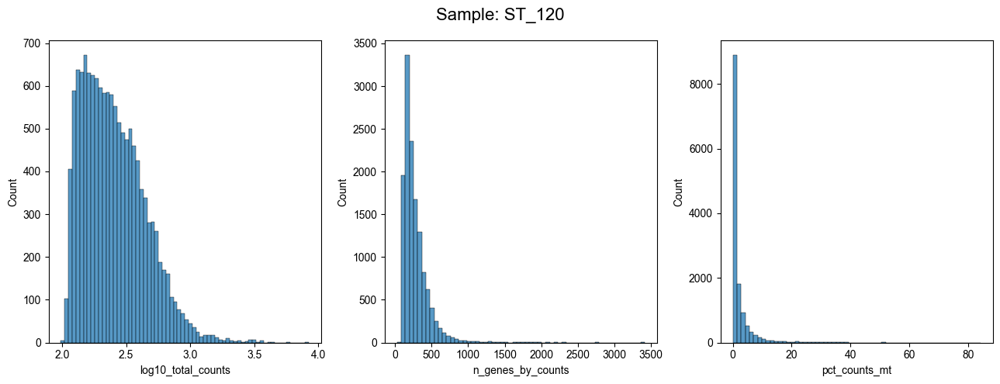

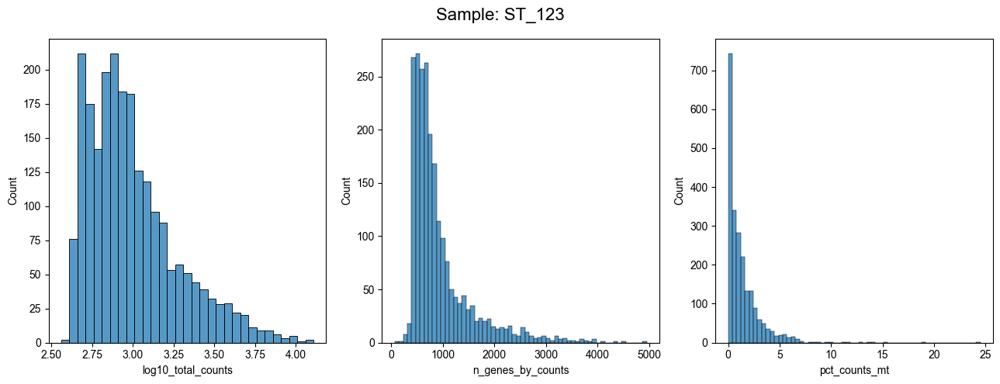

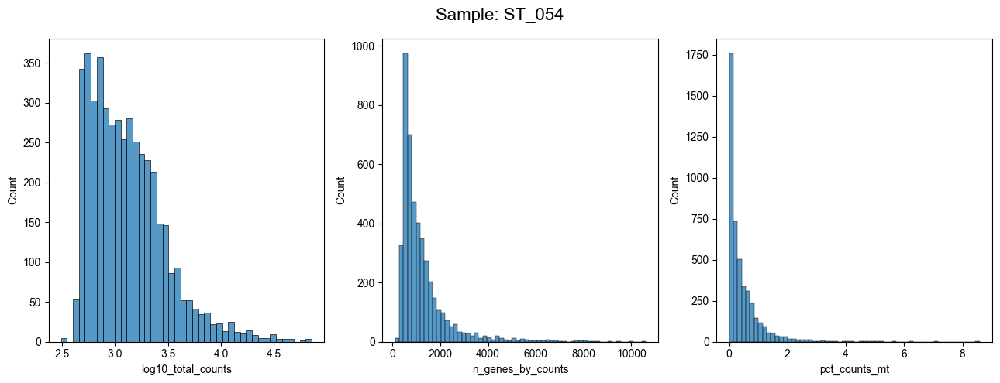

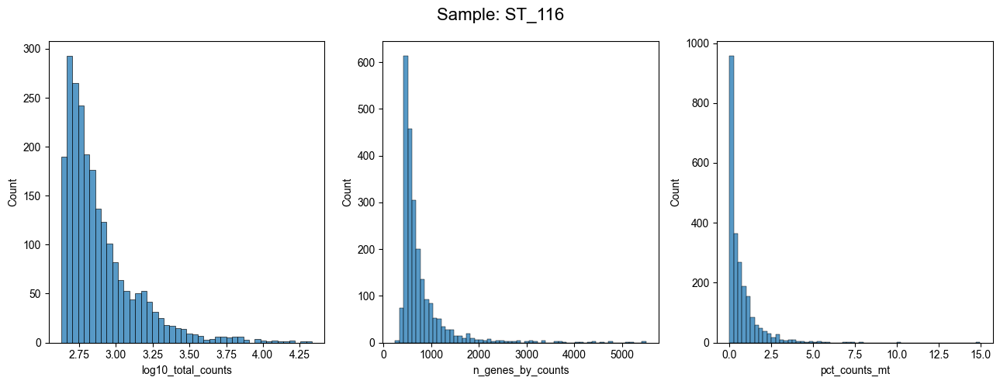

 25%|██▌       | 1/4 [00:14<00:42, 14.05s/it]

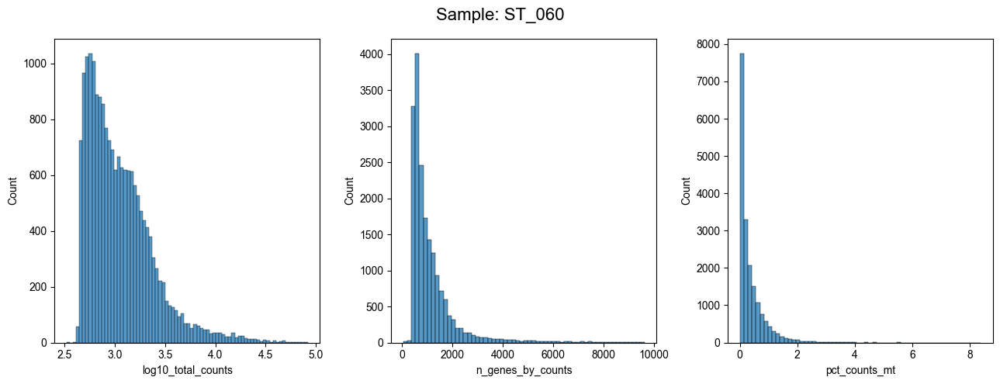

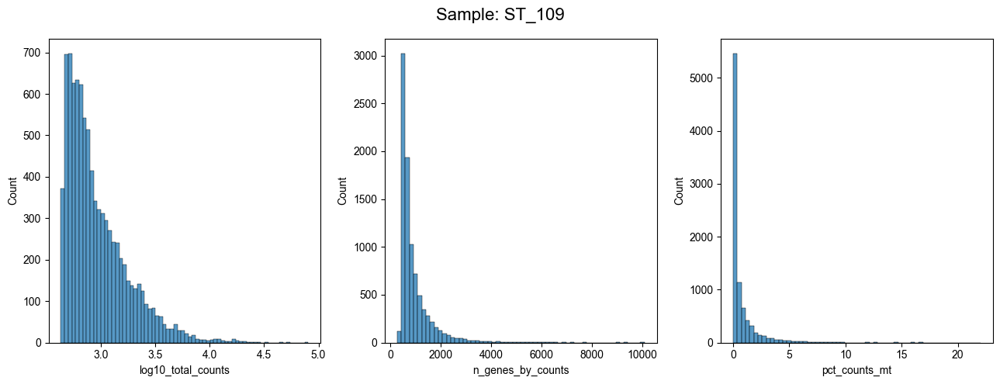

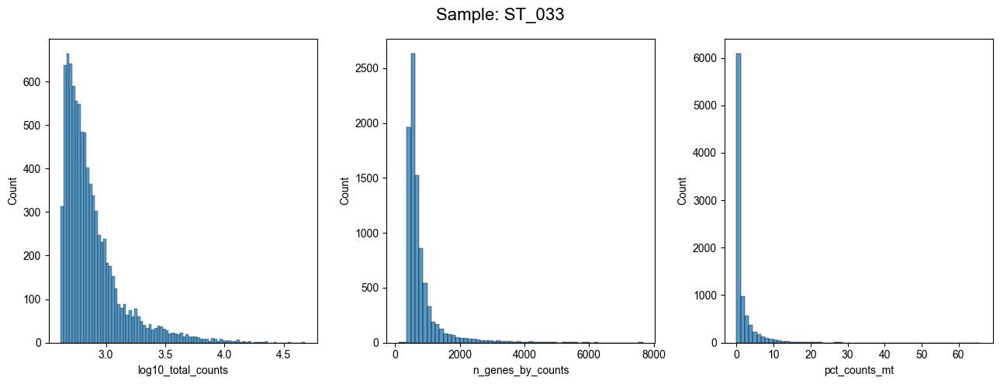

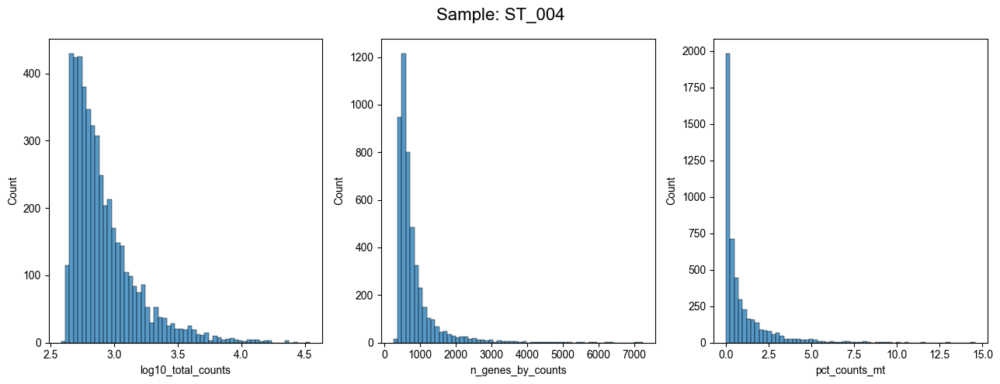

 50%|█████     | 2/4 [00:38<00:39, 19.90s/it]

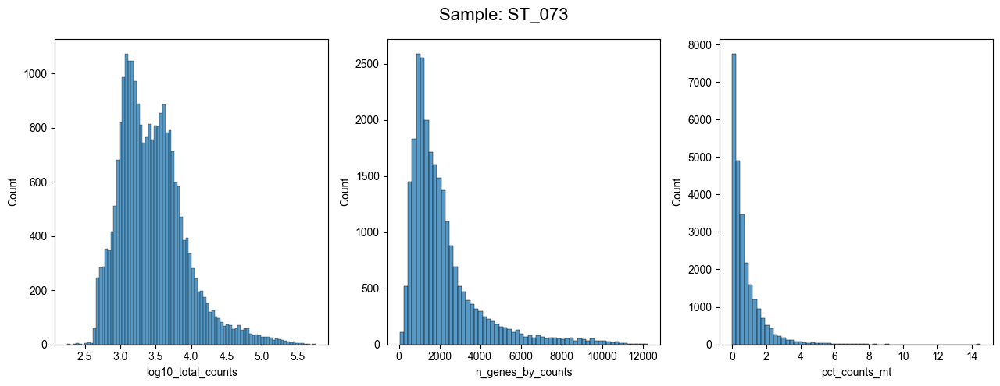

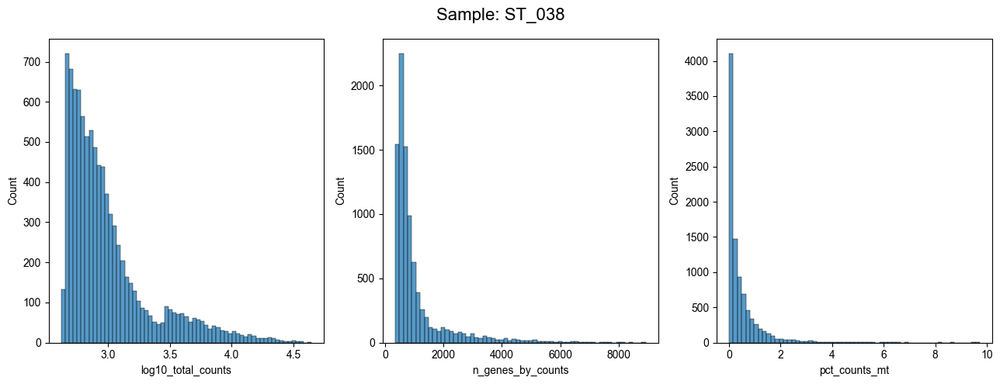

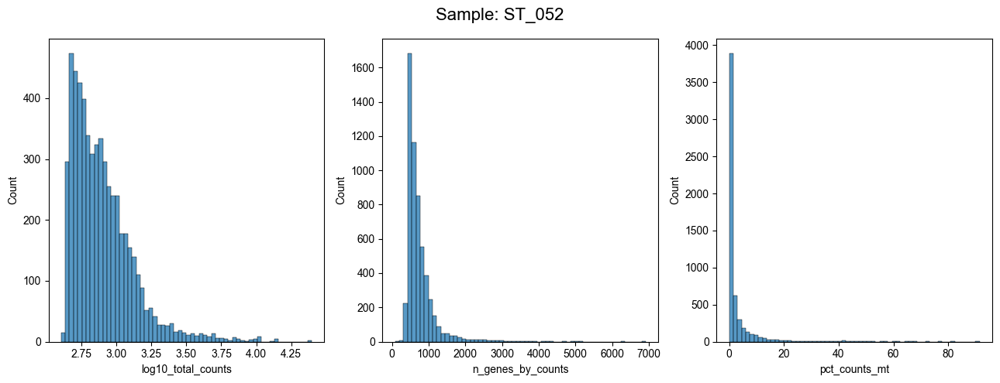

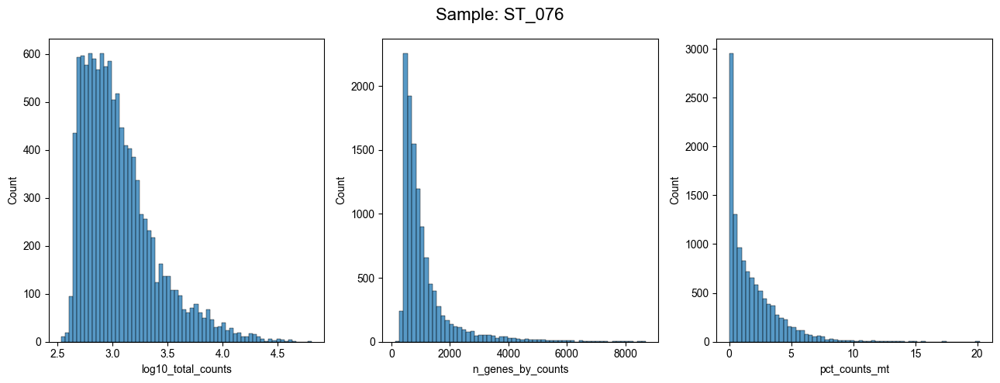

 75%|███████▌  | 3/4 [01:16<00:28, 28.56s/it]

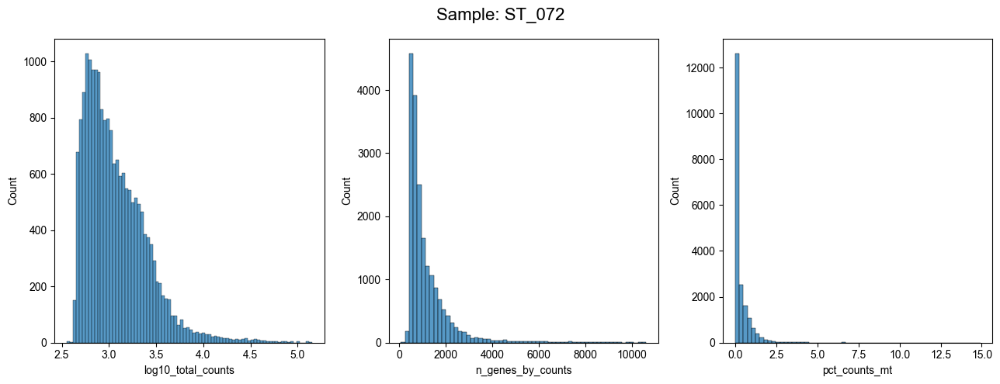

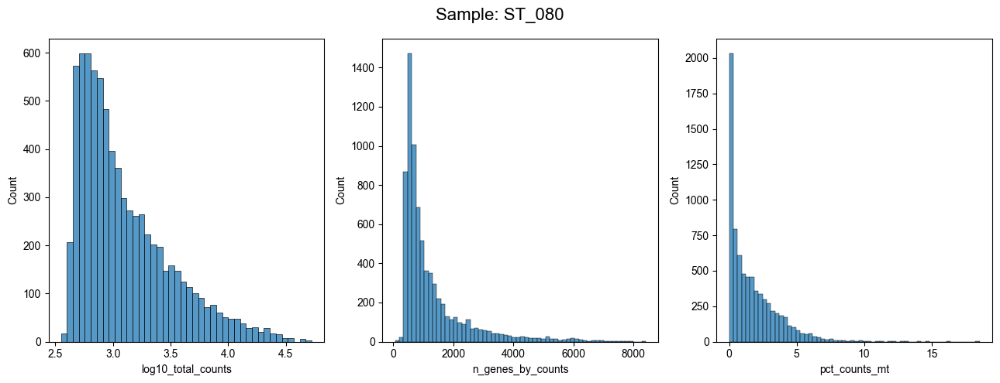

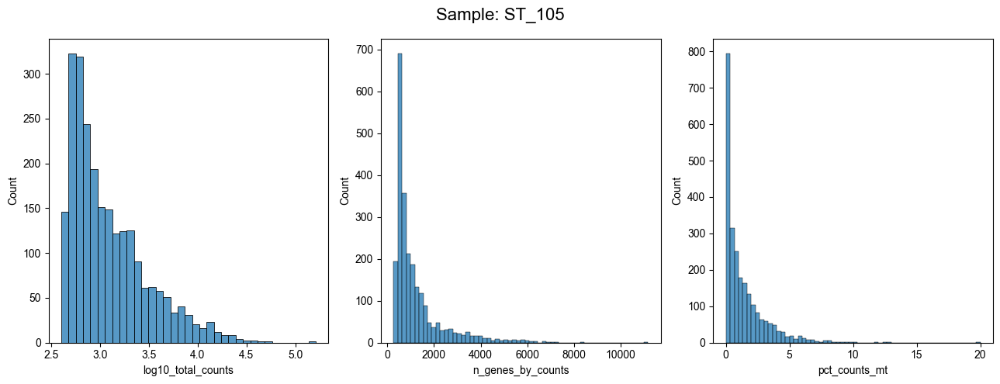

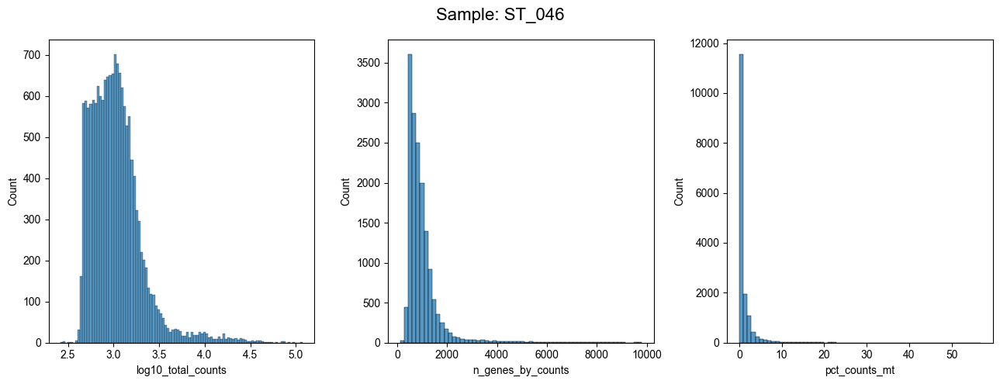

100%|██████████| 4/4 [01:44<00:00, 26.22s/it]


In [9]:
# exp1_flex_path = "/mnt/x/common/joint_projects/spatial_celiac/10x_flex/exp1_outs/per_sample_outs/"
path_suffix = "/count/sample_filtered_feature_bc_matrix.h5"
# identify subfolders
ad_list = []
for flex_out_path in tqdm(exps_paths):
    exp_subfolders = [f.path for f in os.scandir(flex_out_path) if f.is_dir()]

    my_batch = flex_out_path.split('/')[-3].split("_")[0]

    for subfolder in exp_subfolders:
        sample_name = subfolder.split('/')[-1]
        ad_path = subfolder + path_suffix
        my_ad = sc.read_10x_h5(ad_path)
        my_ad.var_names_make_unique()
        my_ad.obs['sample_name'] = sample_name
        my_ad.obs['batch'] = my_batch  # default to '-1' if not found
        my_ad.obs['clinical_group'] = all_pts_table.loc[sample_name, 'Group'].lower() if sample_name in all_pts_table.index else np.nan
        # my_ad.obs['disease_class'] = pb_classes_dict.get(sample_name,  np.nan)  # default to 'N/A' if not found
        my_ad.obs['processing_method'] = processing_method.get(sample_name, 'FFPE_sections_200um')
        my_ad.obs_names = my_ad.obs_names + "-B" + my_ad.obs['batch'].astype(str)

        my_ad.var["mt"] = my_ad.var_names.str.startswith("MT-")
        sc.pp.calculate_qc_metrics(my_ad, qc_vars=["mt"], inplace=True)

        # background subtraction
        my_ad.layers['counts'] = my_ad.X.copy()
        bg_counts = my_ad[(my_ad.obs.total_counts > 100) & (my_ad.obs.total_counts < 500)].X.mean(axis=0).A1
        my_ad.layers['bg_subtracted'] = my_ad.layers['counts'] - bg_counts
        my_ad.layers['bg_subtracted'][my_ad.layers['bg_subtracted'] < 0] = 0
        my_ad.layers['bg_subtracted'] = scipy.sparse.csr_matrix(my_ad.layers['bg_subtracted'])

        my_ad.X = my_ad.layers['bg_subtracted']
        sc.pp.calculate_qc_metrics(my_ad, qc_vars=["mt"], inplace=True)

        my_ad.obs['log10_total_counts'] = np.log10(my_ad.obs['total_counts'] + 1)

        # Plot QC metrics:
        fig, axs = plt.subplots(1, 3, figsize=(13, 5))
        # sns.histplot(my_ad.obs["total_counts"], kde=False, ax=axs[0]) #  I REMOVD THIS ONE AND CHANGED THE OTHER INDECIES
        sns.histplot(my_ad.obs["log10_total_counts"], kde=False, ax=axs[0])
        sns.histplot(my_ad.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[1])
        sns.histplot(my_ad.obs["pct_counts_mt"], kde=False, bins=60, ax=axs[2])
        fig.suptitle(f"Sample: {sample_name}", fontsize=16)
        fig.tight_layout()
        plt.show()

        ad_list.append(my_ad)

In [10]:
adata = ad_list[0].concatenate(ad_list[1:])
adata

AnnData object with n_obs × n_vars = 160539 × 18129
    obs: 'sample_name', 'batch', 'clinical_group', 'processing_method', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'log10_total_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts-0', 'mean_counts-0', 'log1p_mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'log1p_total_counts-0', 'n_cells_by_counts-1', 'mean_counts-1', 'log1p_mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'log1p_total_counts-1', 'n_cells_by_counts-10', 'mean_counts-10', 'log1p_mean_counts-10', 'pct_dropout_by_counts-10', 'total_counts-10', 'log1p_total_counts-10', 'n_cells_by_counts-11', 'mean_counts-11', 'log1p_mean_counts-11', 'pct_dropout_by_counts-11', 'total_counts-11', 'log1p_total_cou

In [11]:
# drop specific patients
patients_to_drop = ["ST_060","ST_073","ST_080","ST_109","ST_120"]
# exclusion of 80/109/12- - celiac w/o 2nd part inflammation
# exclusion of 60/73 - villi are not fully blunted
# print how many cells will be dropped
print(f"Dropping {sum(adata.obs['sample_name'].isin(patients_to_drop))} cells from {len(patients_to_drop)} patients.")
adata = adata[~adata.obs['sample_name'].isin(patients_to_drop), :].copy()
adata

Dropping 73652 cells from 5 patients.


AnnData object with n_obs × n_vars = 86887 × 18129
    obs: 'sample_name', 'batch', 'clinical_group', 'processing_method', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'log10_total_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts-0', 'mean_counts-0', 'log1p_mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'log1p_total_counts-0', 'n_cells_by_counts-1', 'mean_counts-1', 'log1p_mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'log1p_total_counts-1', 'n_cells_by_counts-10', 'mean_counts-10', 'log1p_mean_counts-10', 'pct_dropout_by_counts-10', 'total_counts-10', 'log1p_total_counts-10', 'n_cells_by_counts-11', 'mean_counts-11', 'log1p_mean_counts-11', 'pct_dropout_by_counts-11', 'total_counts-11', 'log1p_total_coun

In [12]:
# adata.layers['counts'] = adata.X.copy()
adata.layers['mat_norm'] = sc.pp.normalize_total(adata, target_sum=1, inplace=False)['X']
adata.layers['log_norm'] = sc.pp.log1p(sc.pp.normalize_total(adata, target_sum=10000, inplace=False)['X'], copy=True)

In [13]:
UMI_THRESH = 500
UMI_MAX = 10000
MT_THRESH = 10


my_palette = sns.color_palette("husl", n_colors=adata.obs['sample_name'].nunique())

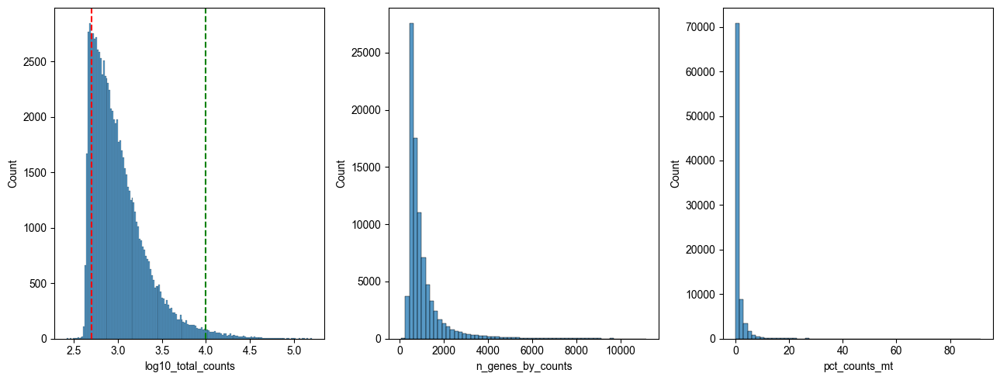

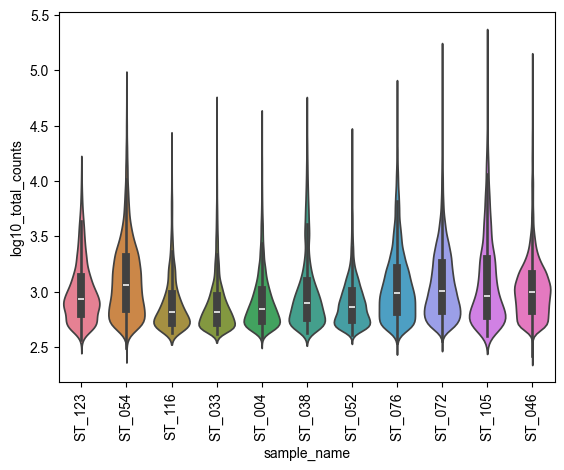

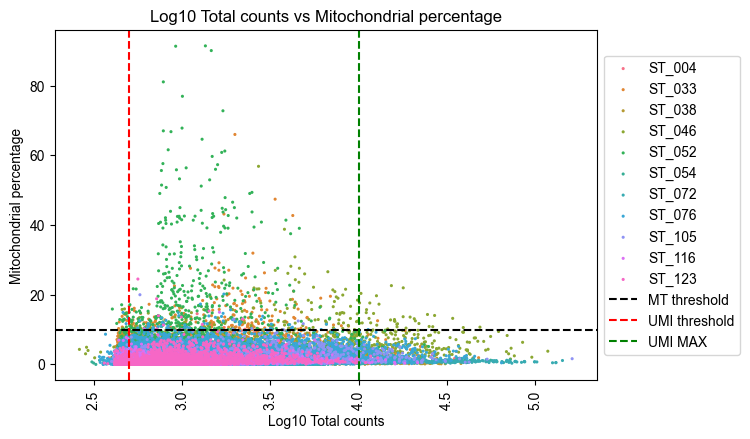

(86887, 18129)
(76383, 18129)
(75604, 18129)


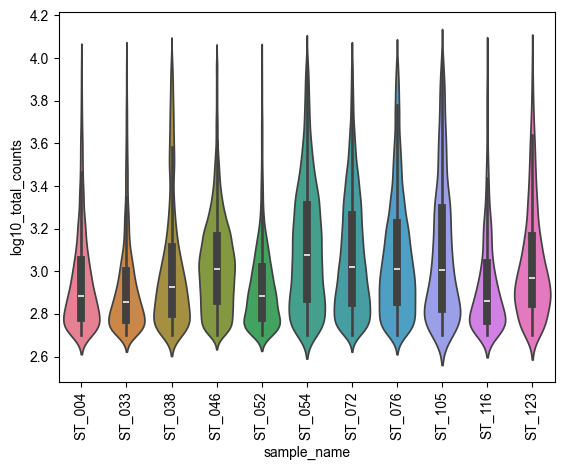

In [14]:
adata.var["mt"] = adata.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True)
adata.obs['log10_total_counts'] = np.log10(adata.obs['total_counts'] + 1)

# Plot QC metrics:
fig, axs = plt.subplots(1, 3, figsize=(13, 5))
# sns.histplot(adata.obs["total_counts"], kde=False, ax=axs[0])
sns.histplot(adata.obs["log10_total_counts"], kde=False, ax=axs[0])
# add UMI_THRESH and UMI_MAX lines
axs[0].axvline(np.log10(UMI_THRESH), color='red', linestyle='--', label='UMI threshold')
axs[0].axvline(np.log10(UMI_MAX), color='green', linestyle='--', label='UMI MAX')
sns.histplot(adata.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[1])
sns.histplot(adata.obs["pct_counts_mt"], kde=False, bins=60, ax=axs[2])
fig.tight_layout()
plt.show() 

sns.violinplot(adata.obs, x='sample_name', y='log10_total_counts', hue='sample_name', palette=my_palette)
plt.xticks(rotation=90)
plt.show()

sc.pl.scatter(adata, "log10_total_counts", "pct_counts_mt", color="sample_name", show=False, size=20, palette=my_palette)
ax = plt.gca()
# add a horizontal line at MT_THRESH
plt.axhline(MT_THRESH, color='black', linestyle='--', label='MT threshold')
plt.axvline(np.log10(UMI_THRESH), color='red', linestyle='--', label='UMI threshold')
plt.axvline(np.log10(UMI_MAX), color='green', linestyle='--', label='UMI MAX')
plt.xlabel("Log10 Total counts")
plt.xticks(rotation=90)
plt.ylabel("Mitochondrial percentage")
plt.title("Log10 Total counts vs Mitochondrial percentage")
# rotate xtickslabels
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

# filter cells with too high/low UMI counts
print(adata.shape)
adata = adata[adata.obs['total_counts'] < UMI_MAX, :]
adata = adata[adata.obs['total_counts'] > UMI_THRESH, :]
print(adata.shape)
# filter cells with high mitochondrial content
mt_mask = adata.obs["pct_counts_mt"] < MT_THRESH
adata = adata[mt_mask, :]
print(adata.shape)
sns.violinplot(adata.obs, x='sample_name', y='log10_total_counts', hue='sample_name', palette=my_palette)
plt.xticks(rotation=90)
plt.show()

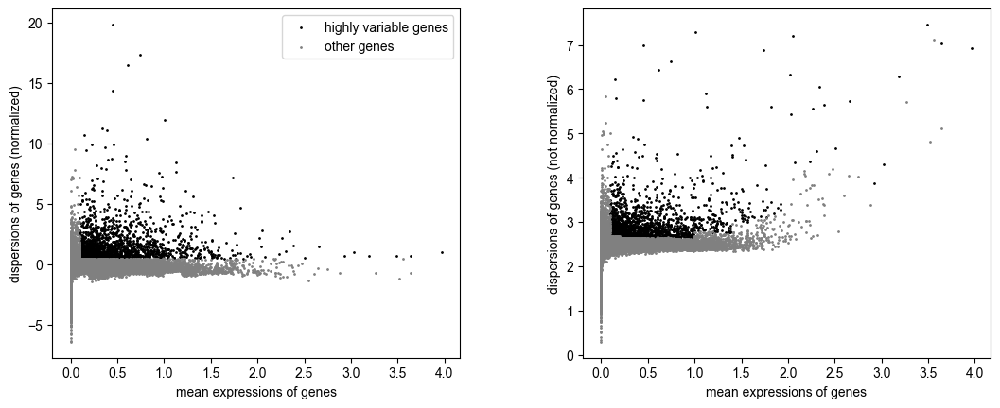

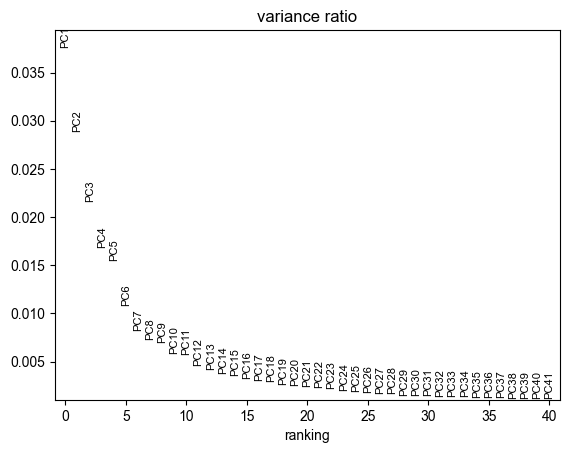

In [15]:
adata = recluster(adata, n_pcs=30, n_neighbors=10)

In [16]:
sc.tl.leiden(adata, resolution=0.2, random_state=1) # controls the number of clusters you would get. Reduce value to get more clusters.

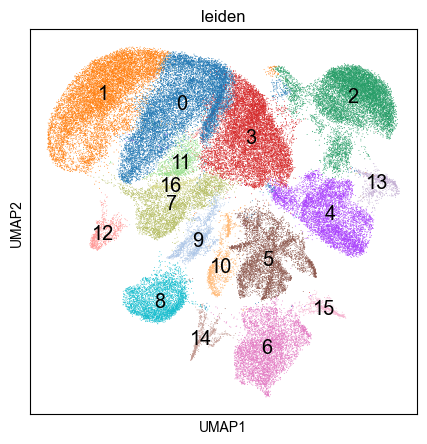

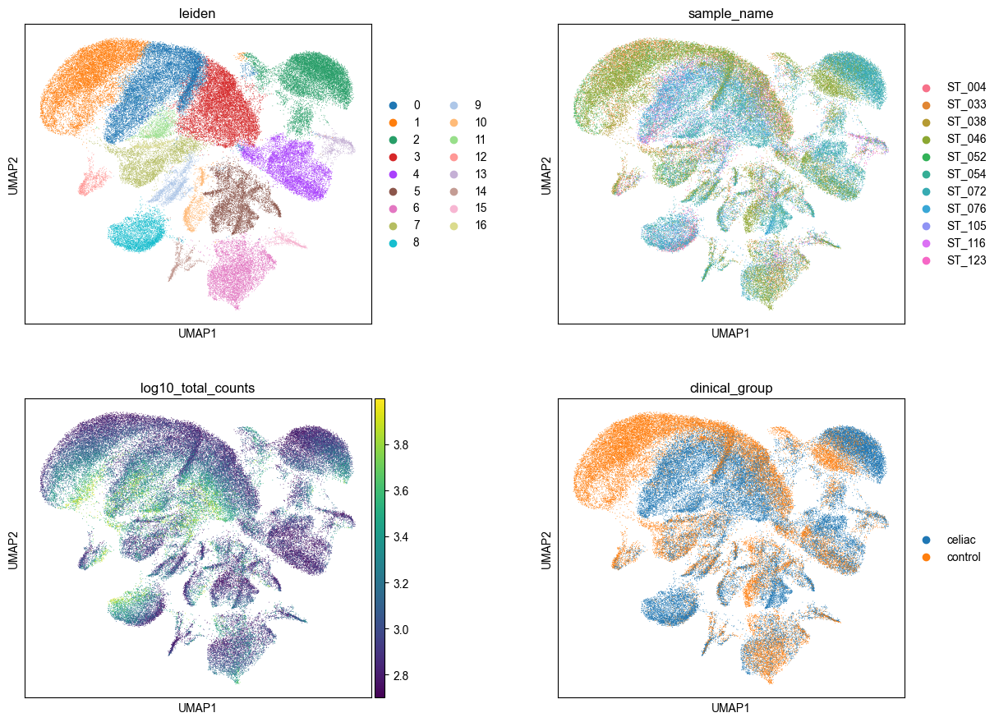

In [17]:
# Plot umap
plt.rcParams["figure.figsize"] = (5, 5)

# Ensure the color list matches the number of clusters
sc.pl.umap(adata, color=["leiden",],legend_loc='on data', legend_fontweight='heavy', legend_fontsize='x-large')
sc.pl.umap(adata, color=["leiden",'sample_name','log10_total_counts','clinical_group'],wspace=0.4, ncols=2)

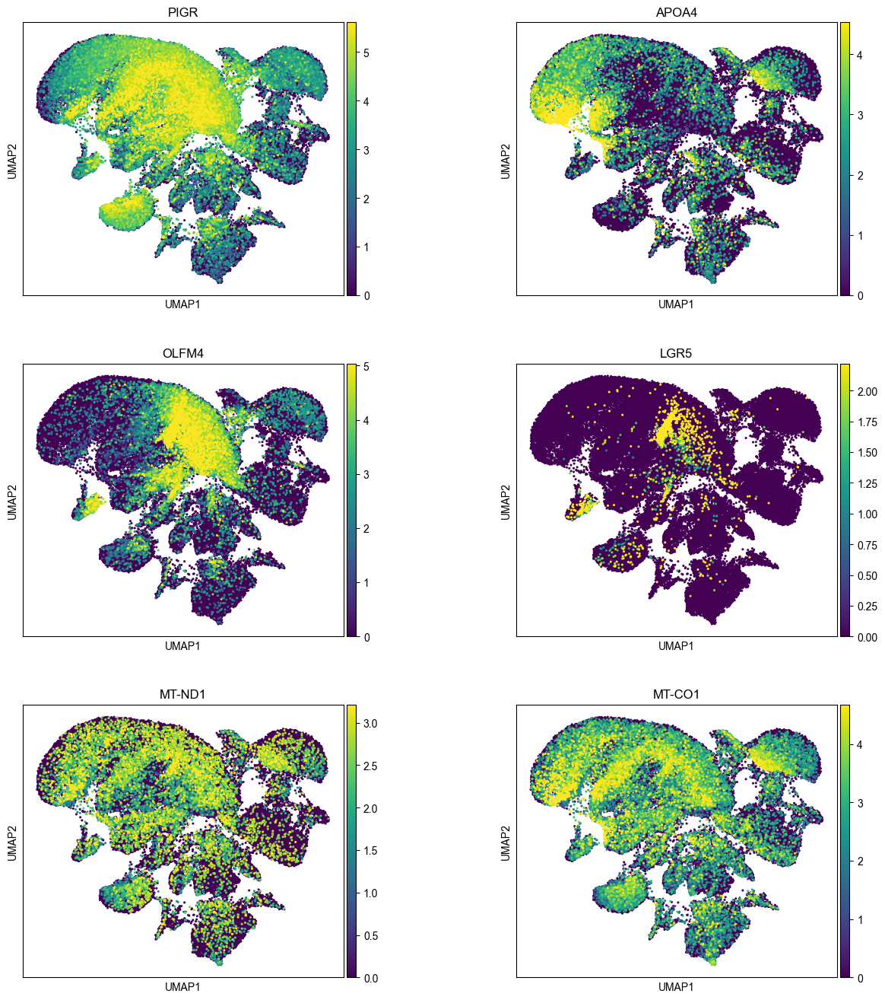

In [18]:
sc.pl.umap(adata, color=["PIGR","APOA4","OLFM4","LGR5","MT-ND1","MT-CO1"],size=20,wspace=0.4, ncols=2, layer='log_norm',vmax='p99')

In [19]:
if SHOW_DGE:
    sc.tl.rank_genes_groups(adata,  groupby='leiden',  method='wilcoxon', layer='log_norm')
    sc.pl.rank_genes_groups(adata,  groupby='leiden',  n_genes=30)

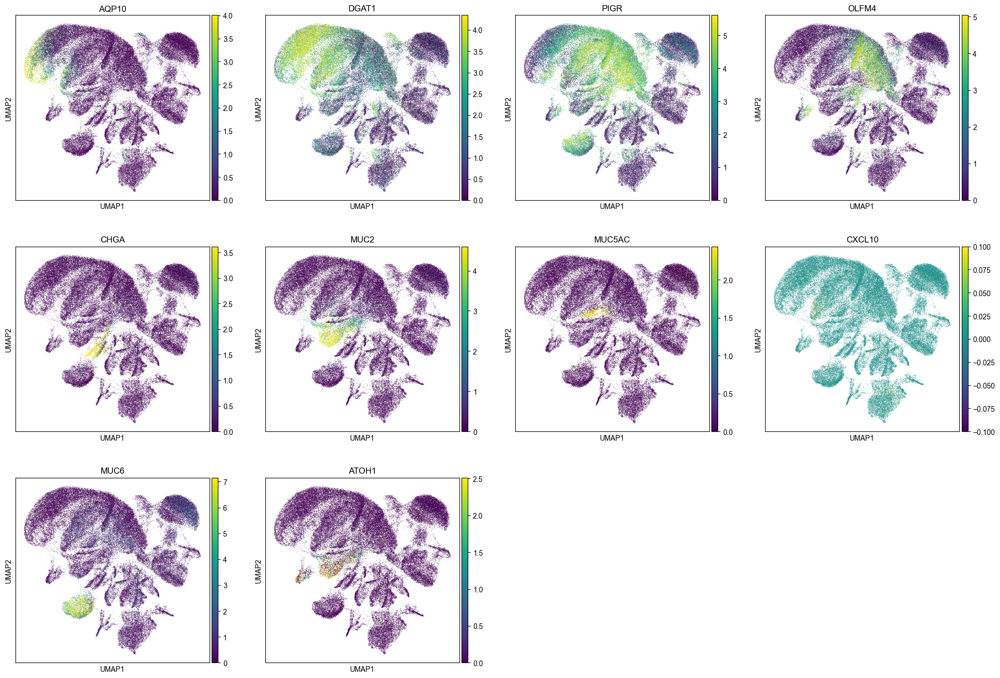

In [20]:
sc.pl.umap(adata, color=["AQP10","DGAT1","PIGR","OLFM4","CHGA","MUC2","MUC5AC","CXCL10","MUC6","ATOH1"],layer='log_norm',vmax='p99')

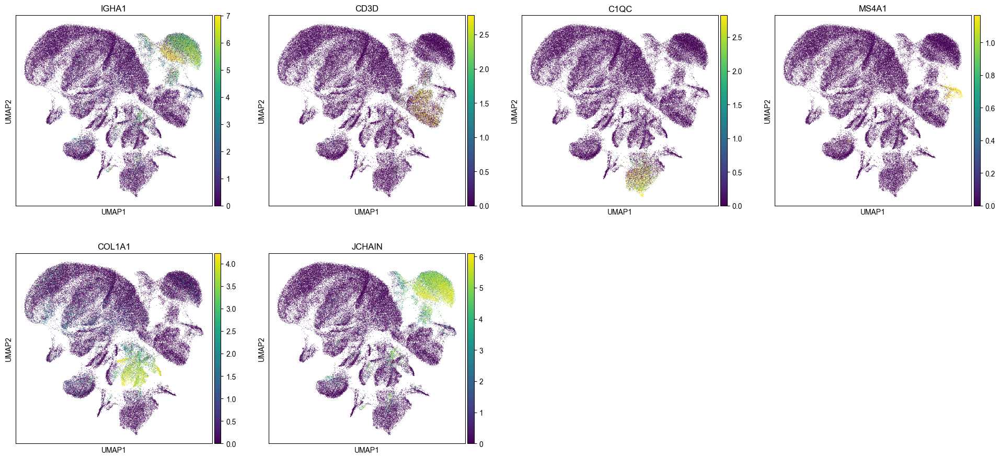

In [21]:
sc.pl.umap(adata, color=["IGHA1","CD3D","C1QC","MS4A1","COL1A1","JCHAIN"],vmax='p99',layer='log_norm')

## Annotate level 1

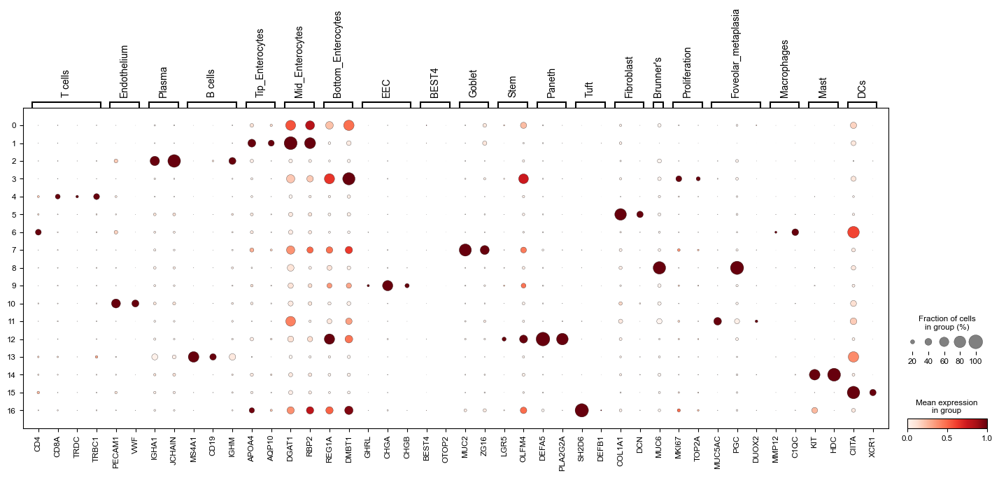

In [22]:
marker_genes = {
    "T cells":["CD4","CD8A","TRDC","TRBC1"],
    'Endothelium':['PECAM1','VWF'],
    "Plasma":["IGHA1","JCHAIN"],
    "B cells":["MS4A1","CD19","IGHM"],
    "Tip_Enterocytes":["APOA4","AQP10"],
    "Mid_Enterocytes":["DGAT1","RBP2"],
    "Bottom_Enterocytes":["REG1A","DMBT1"],
    "EEC":["GHRL","CHGA","CHGB"],
    "BEST4":["BEST4","OTOP2"],
    "Goblet":["MUC2","ZG16"],
    "Stem":["LGR5","OLFM4"],
    "Paneth":["DEFA5","PLA2G2A"],
    "Tuft":["SH2D6","DEFB1"],
    "Fibroblast":["COL1A1","DCN"],
    "Brunner's":["MUC6"],
    "Proliferation":["MKI67","TOP2A",],
    "Foveolar_metaplasia":["MUC5AC","PGC","DUOX2"],
    "Macrophages":["MMP12","C1QC"],
    "Mast":["KIT","HDC"],
    "DCs":["CIITA","XCR1"]
}
sc.pl.dotplot(adata, marker_genes, groupby="leiden", standard_scale="var")

In [23]:
adata.obs['cell_type_lvl1'] = adata.obs.leiden.map({
    "0":"Epithelium",#
    "1":"Epithelium",#
    "2":"Immune",#
    "3":"Epithelium",#
    "4":"Immune",#
    "5":"Stroma",#
    "6":"Immune",#
    "7":"Epithelium",#
    "8":"Epithelium",#
    "9":"Epithelium",#
    "10":"Stroma",#
    "11":"Epithelium",#
    "12":"Epithelium",#
    "13":"Immune",#
    "14":"Immune",#
    "15":"Immune",
    "16":"Epithelium",#
})

In [24]:
# create dir for pseudobulk data if it doesn't exist
if not os.path.exists("pseudobulk_data"):
    os.makedirs("pseudobulk_data")

# create pseudobulk cell_type_lvl1 data
lvl1_types = adata.obs['cell_type_lvl1'].unique().tolist()
df_pseudobulk_lvl1 = pd.DataFrame(index=adata.var_names)
for ct in lvl1_types:
    cells_of_type = adata[adata.obs['cell_type_lvl1'] == ct]
    pseudobulk_mean = cells_of_type.layers['mat_norm'].mean(axis=0).A1
    df_pseudobulk_lvl1[ct] = pseudobulk_mean
df_pseudobulk_lvl1.to_csv("pseudobulk_data/pseudobulk_cell_type_lvl1_bg_subtracted_UMI500.csv")

In [25]:
top_N_genes = 10
FC_THRESH = 10
EXP_THRESH = 1e-4
PN=1e-6

top_genes_dict = {}
for ct in lvl1_types:
    cells_of_type = df_pseudobulk_lvl1.loc[:,df_pseudobulk_lvl1.columns == ct]
    other_cells = df_pseudobulk_lvl1.loc[:,df_pseudobulk_lvl1.columns != ct]

    mean_expr_ct = cells_of_type.mean(axis=1)
    max_expr_other = other_cells.max(axis=1)

    selected_genes_mask = (mean_expr_ct > EXP_THRESH) & (mean_expr_ct > FC_THRESH * max_expr_other)
    selected_genes_names = df_pseudobulk_lvl1.index[selected_genes_mask]

    # sort selected genes by fold change
    fold_changes = mean_expr_ct[selected_genes_mask] / (max_expr_other[selected_genes_mask] + PN)
    selected_genes_names = selected_genes_names[np.argsort(-fold_changes)]

    print(f"Cell type: {ct}, selected marker genes: {len(selected_genes_names)}")
    top_genes_dict[ct] = selected_genes_names.tolist()[:top_N_genes]
    

Cell type: Epithelium, selected marker genes: 14
Cell type: Immune, selected marker genes: 35
Cell type: Stroma, selected marker genes: 250


In [26]:
top_genes_dict

{'Epithelium': ['DEFA5',
  'CLCA1',
  'MLN',
  'FER1L6',
  'CHGA',
  'HEPACAM2',
  'DEFA6',
  'CAPN8',
  'FCGBP',
  'REG3A'],
 'Immune': ['MS4A6A',
  'SIGLEC1',
  'MS4A2',
  'HDC',
  'CD163L1',
  'MS4A4E',
  'CD209',
  'LILRB5',
  'CSF1R',
  'CLEC10A'],
 'Stroma': ['RIPOR3',
  'ALDH1A3',
  'CDH5',
  'ADAM33',
  'TNXB',
  'EGFL7',
  'DAAM2',
  'RAMP3',
  'ABCA8',
  'BMP5']}

## Annotate level 2

In [27]:
epithelial_subtypes = ['Epithelium']
non_epithelial_subtypes = np.setdiff1d(adata.obs['cell_type_lvl1'].unique().tolist(), epithelial_subtypes)

print(epithelial_subtypes)
print(non_epithelial_subtypes)

['Epithelium']
['Immune' 'Stroma']


In [28]:
def filter_gene(my_adata, gene_name, exp_thresh, plot_hist=False, text_report=True, use_layer='mat_norm'):
    gene_exp = my_adata[:, gene_name].layers[use_layer].toarray().flatten()
    gene_mask = gene_exp < exp_thresh
    if text_report:
        print(f"Number of cells before {gene_name} filtering: {my_adata.shape[0]}")
        print(f"Number of cells after {gene_name} filtering: {np.sum(gene_mask)}")
        print(f"Number of cells removed: {my_adata.shape[0] - np.sum(gene_mask)}")
    if plot_hist:
        plt.hist(gene_exp, bins=100)
        plt.axvline(x=np.log(1 + exp_thresh * 10000), color='red', linestyle='--')
        plt.title(f"Expression of {gene_name}")
        plt.show()
    # filter
    my_adata = my_adata[gene_mask, :].copy()
    return my_adata

### Epithelium

In [29]:
epi_mask = adata.obs['cell_type_lvl1'].isin(epithelial_subtypes)
print(epi_mask.sum())

epi_ad = adata[epi_mask].copy()

exp_filter_thresh = 1e-4
for gene in ["DCN","JCHAIN","MS4A1","CD4","C1QC","CD3D"]:
    epi_ad = filter_gene(epi_ad, gene, exp_filter_thresh)

epi_ad

45098
Number of cells before DCN filtering: 45098
Number of cells after DCN filtering: 44888
Number of cells removed: 210
Number of cells before JCHAIN filtering: 44888
Number of cells after JCHAIN filtering: 43187
Number of cells removed: 1701


Number of cells before MS4A1 filtering: 43187
Number of cells after MS4A1 filtering: 43101
Number of cells removed: 86
Number of cells before CD4 filtering: 43101
Number of cells after CD4 filtering: 42852
Number of cells removed: 249
Number of cells before C1QC filtering: 42852
Number of cells after C1QC filtering: 42717
Number of cells removed: 135
Number of cells before CD3D filtering: 42717
Number of cells after CD3D filtering: 42391
Number of cells removed: 326


AnnData object with n_obs × n_vars = 42391 × 18129
    obs: 'sample_name', 'batch', 'clinical_group', 'processing_method', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'log10_total_counts', 'leiden', 'cell_type_lvl1'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts-0', 'mean_counts-0', 'log1p_mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'log1p_total_counts-0', 'n_cells_by_counts-1', 'mean_counts-1', 'log1p_mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'log1p_total_counts-1', 'n_cells_by_counts-10', 'mean_counts-10', 'log1p_mean_counts-10', 'pct_dropout_by_counts-10', 'total_counts-10', 'log1p_total_counts-10', 'n_cells_by_counts-11', 'mean_counts-11', 'log1p_mean_counts-11', 'pct_dropout_by_counts-11', 'total_c

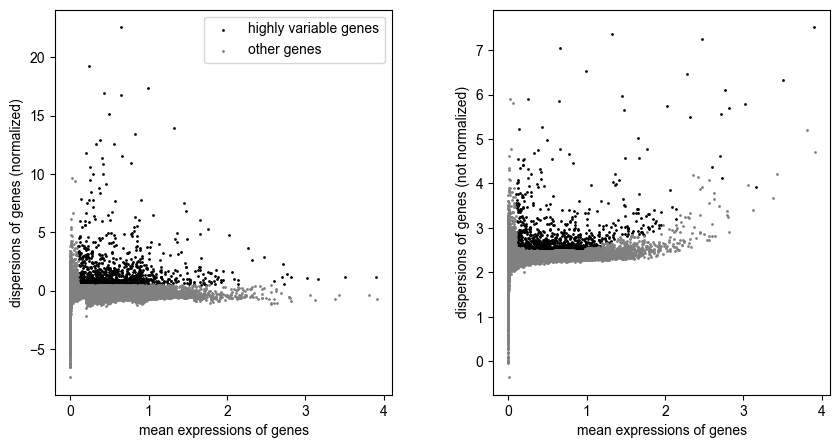

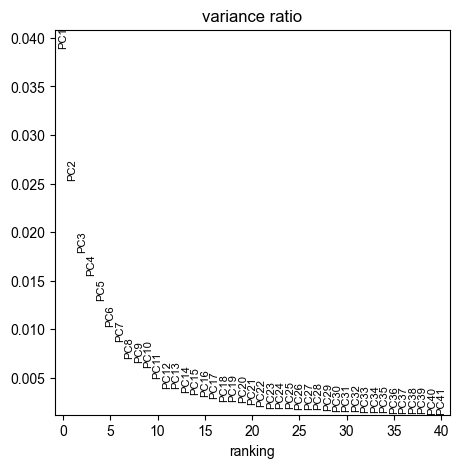

In [30]:
my_npcs = 30
epi_ad = recluster(epi_ad, n_pcs=my_npcs, n_neighbors=10, key_added='epi_leiden_tmp')

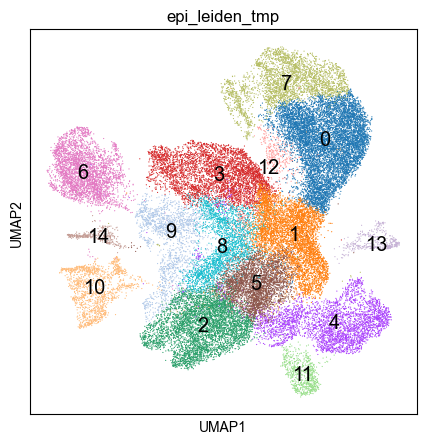

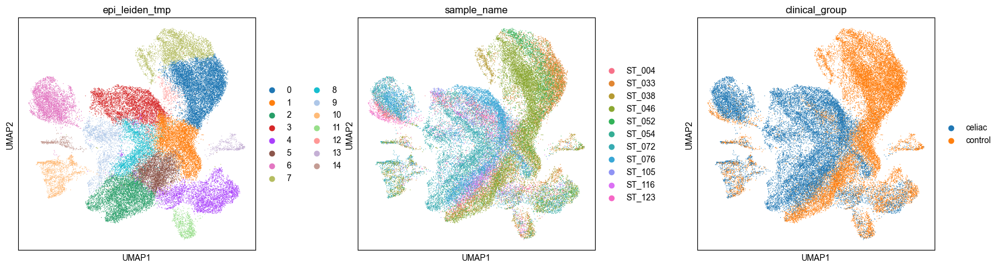

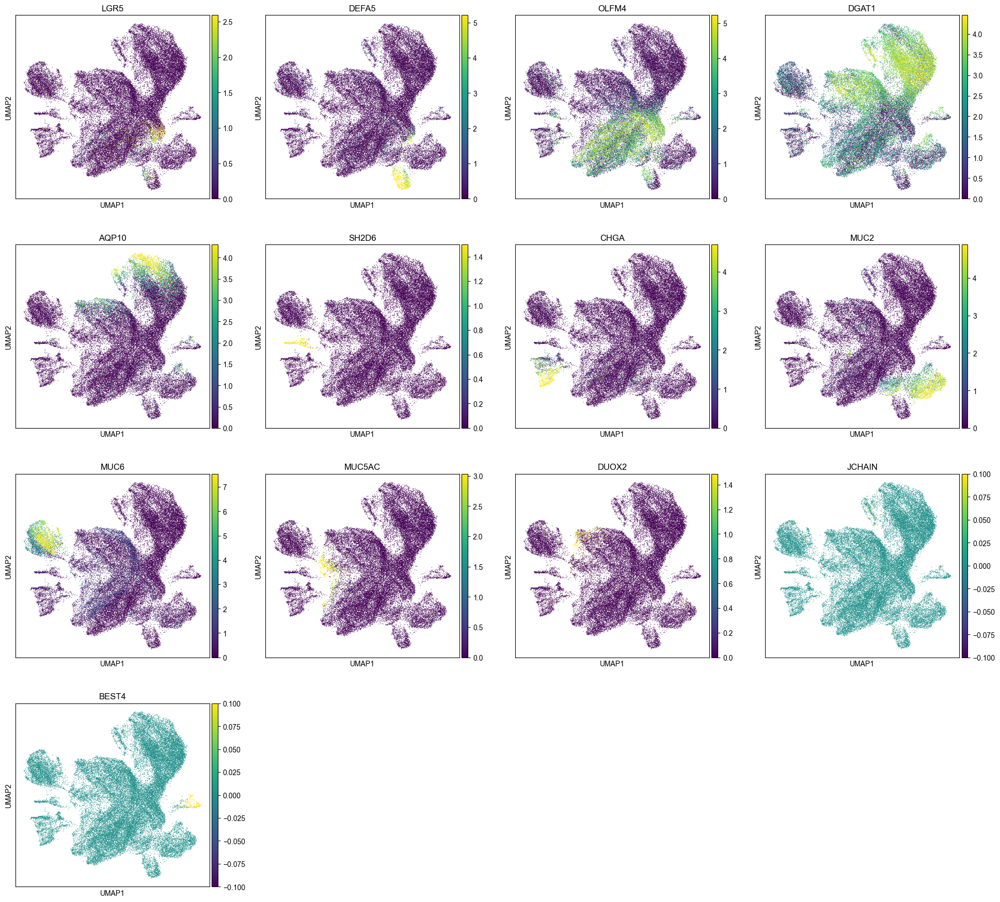

In [31]:
# Plot umap
plt.rcParams["figure.figsize"] = (5, 5)

# Ensure the color list matches the number of clusters
n_leiden = epi_ad.obs['epi_leiden_tmp'].nunique()
# epi_ad.uns['epi_leiden_colors'] = sns.color_palette("husl", n_colors=n_leiden).as_hex()

sc.pl.umap(epi_ad, color=["epi_leiden_tmp",],legend_loc='on data', legend_fontweight='heavy', legend_fontsize='x-large')
sc.pl.umap(epi_ad, color=["epi_leiden_tmp",'sample_name','clinical_group'],wspace=0.3)
sc.pl.umap(epi_ad, color=["LGR5","DEFA5","OLFM4","DGAT1","AQP10","SH2D6","CHGA","MUC2","MUC6","MUC5AC","DUOX2",'JCHAIN',"BEST4"], layer='log_norm', vmax='p99')

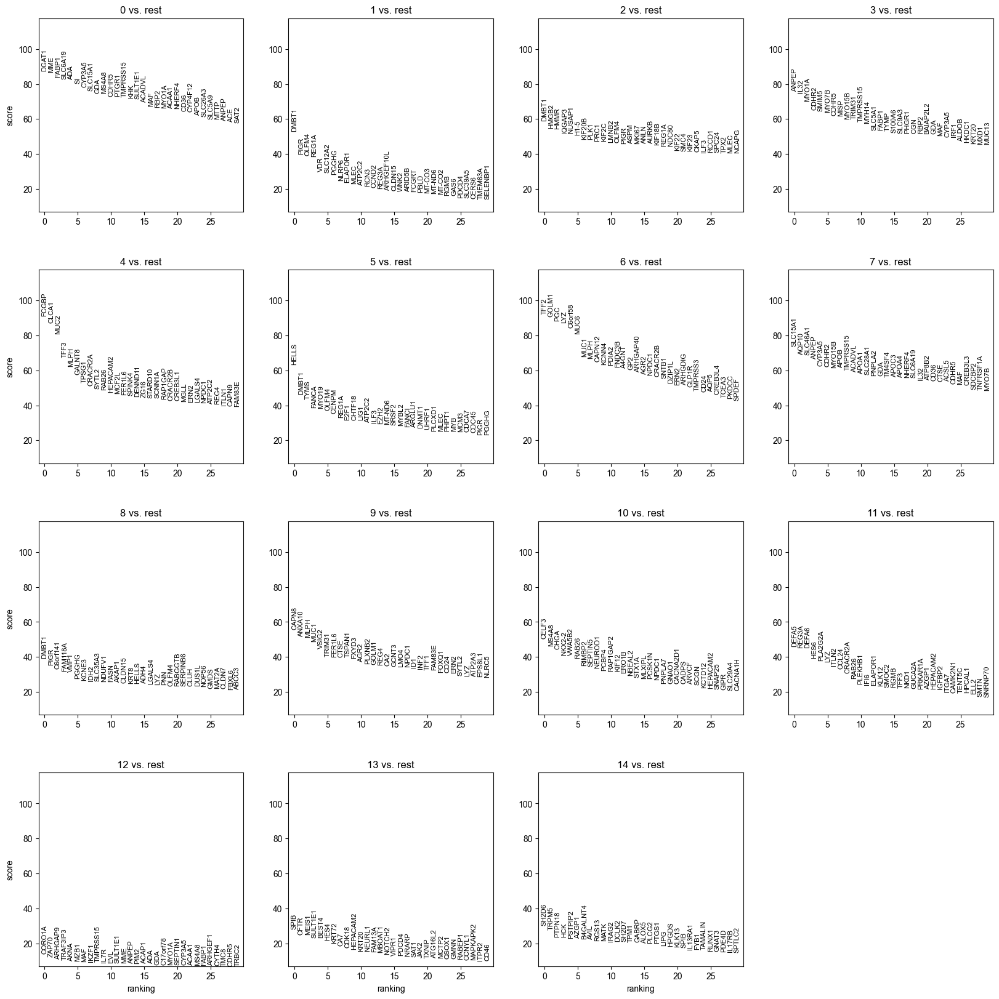

In [32]:
sc.tl.rank_genes_groups(epi_ad,  groupby='epi_leiden_tmp',  method='wilcoxon', layer='log_norm')
sc.pl.rank_genes_groups(epi_ad,  groupby='epi_leiden_tmp',  n_genes=30)

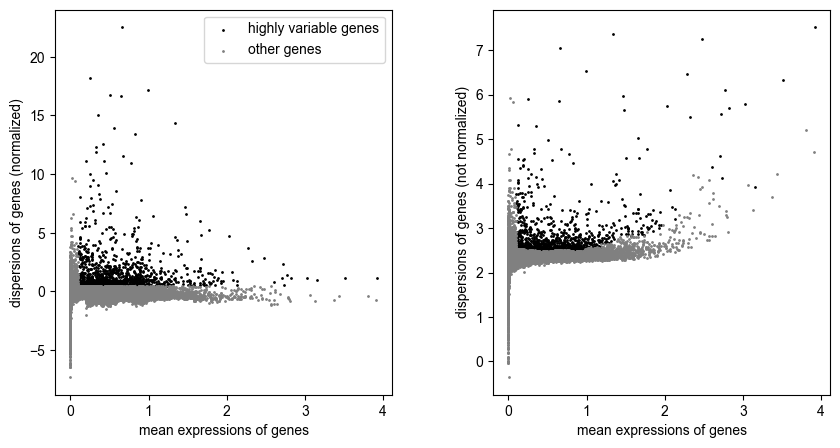

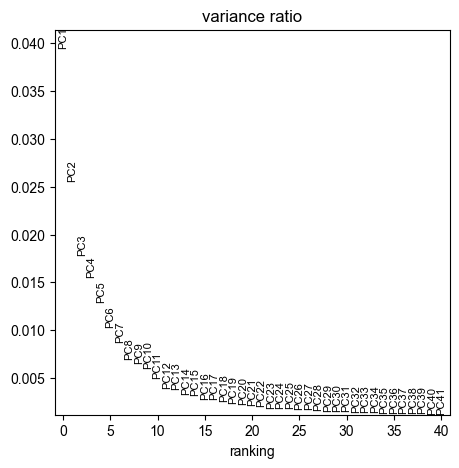

In [33]:
# drop cluster 12 (doublets)
epi_ad = epi_ad[epi_ad.obs['epi_leiden_tmp'] != '12'].copy()
epi_ad = recluster(epi_ad, n_pcs=my_npcs, n_neighbors=10, key_added='epi_leiden', resolution=0.75)

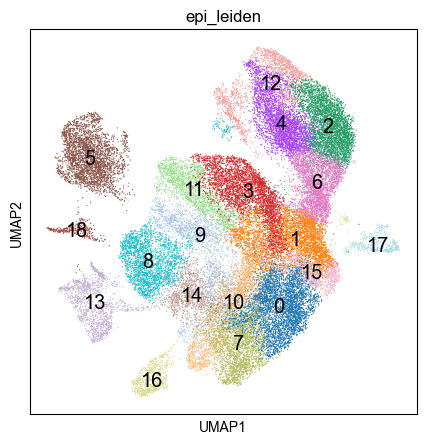

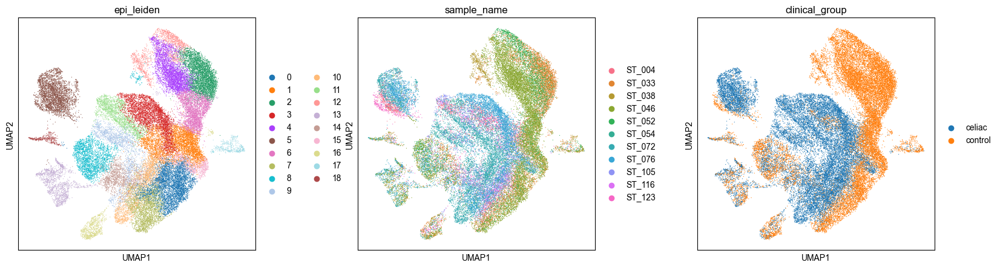

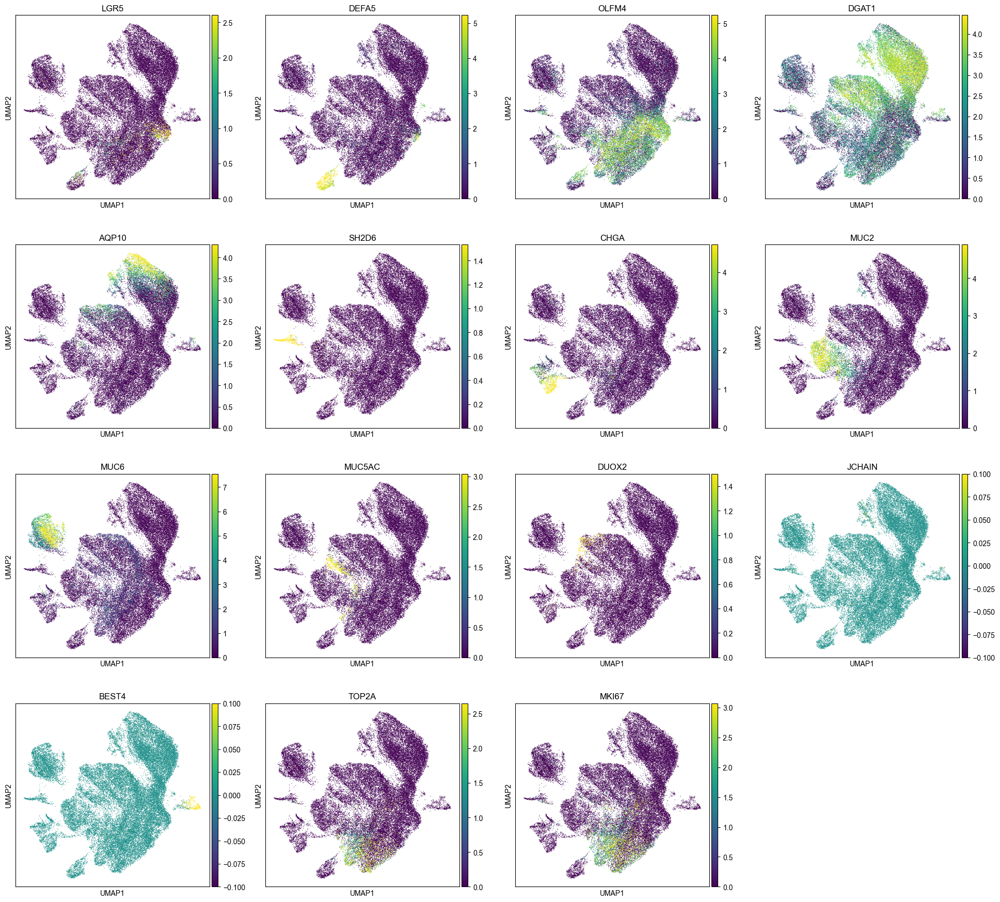

In [34]:
# Plot umap
plt.rcParams["figure.figsize"] = (5, 5)

# Ensure the color list matches the number of clusters
n_leiden = epi_ad.obs['epi_leiden'].nunique()
# epi_ad.uns['epi_leiden_colors'] = sns.color_palette("husl", n_colors=n_leiden).as_hex()

sc.pl.umap(epi_ad, color=["epi_leiden",],legend_loc='on data', legend_fontweight='heavy', legend_fontsize='x-large')
sc.pl.umap(epi_ad, color=["epi_leiden",'sample_name','clinical_group'],wspace=0.3)
sc.pl.umap(epi_ad, color=["LGR5","DEFA5","OLFM4","DGAT1","AQP10","SH2D6","CHGA","MUC2","MUC6","MUC5AC","DUOX2",'JCHAIN',"BEST4","TOP2A","MKI67"], layer='log_norm', vmax='p99')

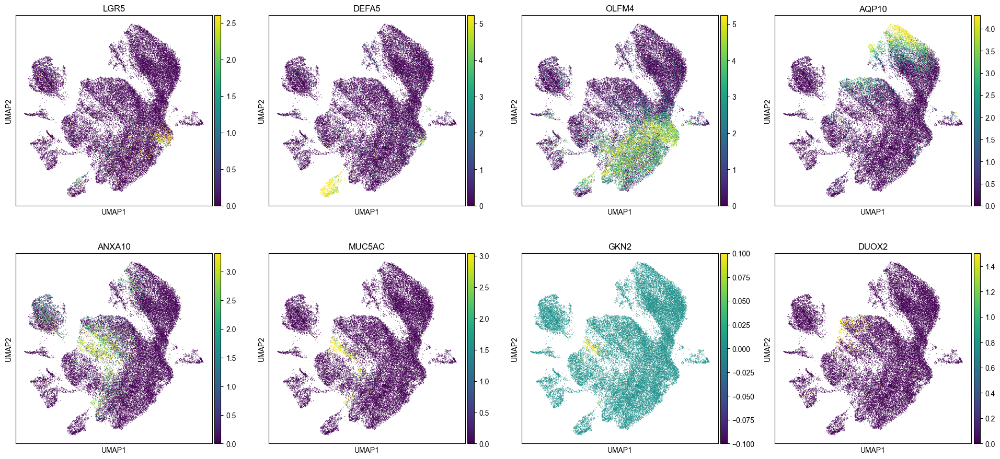

In [35]:
sc.pl.umap(epi_ad, color=["LGR5","DEFA5","OLFM4","AQP10","ANXA10","MUC5AC","GKN2","DUOX2"], layer='log_norm', vmax='p99')

In [36]:
if SHOW_DGE:
    sc.tl.rank_genes_groups(epi_ad,  groupby='epi_leiden',  method='wilcoxon', layer='log_norm')
    sc.pl.rank_genes_groups(epi_ad,  groupby='epi_leiden',  n_genes=30)

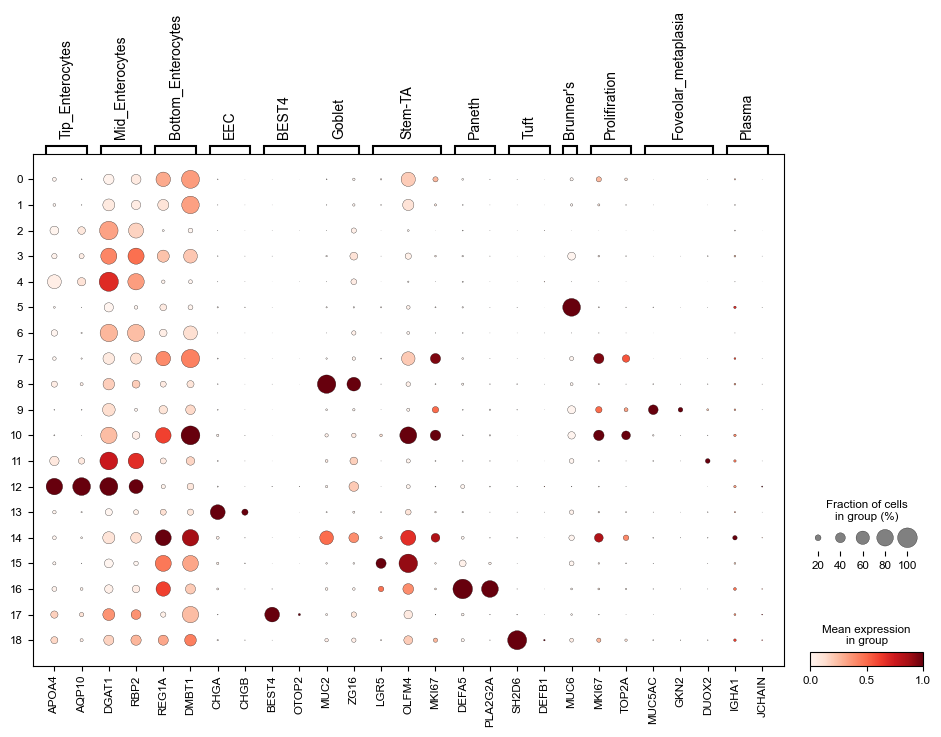

In [37]:
marker_genes = {
    "Tip_Enterocytes":["APOA4","AQP10"],
    "Mid_Enterocytes":["DGAT1","RBP2"],
    "Bottom_Enterocytes":["REG1A","DMBT1"],
    "EEC":["CHGA","CHGB"],
    "BEST4":["BEST4","OTOP2"],
    "Goblet":["MUC2","ZG16"],
    "Stem-TA":["LGR5","OLFM4","MKI67"],
    "Paneth":["DEFA5","PLA2G2A"],
    "Tuft":["SH2D6","DEFB1"],
    "Brunner's":["MUC6"],
    "Prolifiration":["MKI67","TOP2A",],
    "Foveolar_metaplasia":["MUC5AC","GKN2","DUOX2"],
    "Plasma":["IGHA1","JCHAIN"],
}
sc.pl.dotplot(epi_ad, marker_genes, groupby="epi_leiden", standard_scale="var")

In [38]:
print(my_npcs)
if my_npcs == 30:
    epi_ad.obs['cell_type_lvl2'] = epi_ad.obs.epi_leiden.map({
    "0":"TA",
    "1":"Enterocytes",
    "2":"Enterocytes",
    "3":"Enterocytes",
    "4":"Enterocytes",
    "5":"Brunner",
    "6":"Enterocytes",
    "7":"TA",
    "8":"Goblet",
    "9":"MUC5AC_metaplasia",
    "10":"TA",
    "11":"DUOX2_Enterocytes",
    "12":"Enterocytes",
    "13":"EEC",
    "14":"Goblet",
    "15":"Stem",
    "16":"Paneth",
    "17":"BEST4",
    "18":"Tuft",
})
else:
    print("Please check the mapping for cell_type_lvl2!")

30


In [39]:
adata_tmp = adata.copy()

In [40]:
adata = adata_tmp.copy()

In [41]:
adata.obs.cell_type_lvl2 = np.nan
# adata.obs.cell_type_lvl3 = np.nan

In [42]:
# adata.obs.loc[epi_ad.obs_names, 'cell_type_lvl3'] = epi_ad.obs['cell_type_lvl2']
# adata.obs.loc[entero_ad.obs_names, 'cell_type_lvl3'] = entero_ad.obs['cell_type_lvl3']

# # update adata with cell_type_lvl2 from epi_ad
adata.obs.loc[epi_ad.obs_names, 'cell_type_lvl2'] = epi_ad.obs['cell_type_lvl2']
# adata.obs.loc[epi_ad.obs_names, 'cell_type_lvl3'] = epi_ad.obs['cell_type_lvl3']


# keep coordinates of epi_ad and entero_ad
adata.obs[['epi_umap1','epi_umap2']] = np.nan
adata.obs.loc[epi_ad.obs_names, ['epi_umap1','epi_umap2']] = epi_ad.obsm['X_umap']
adata.obs[['entero_umap1','entero_umap2']] = np.nan
# adata.obs.loc[entero_ad.obs_names, ['entero_umap1','entero_umap2']] = entero_ad.obsm['X_umap']

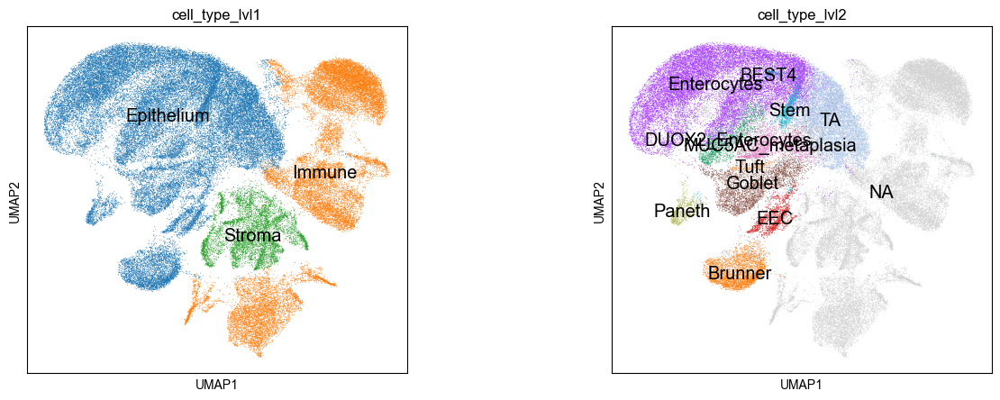

In [43]:
sc.pl.umap(adata, color=['cell_type_lvl1','cell_type_lvl2'], wspace=0.4, ncols=2, legend_loc='on data', legend_fontweight='heavy', legend_fontsize='x-large')

### Stroma

In [44]:
stroma_ad = adata[adata.obs['cell_type_lvl1']=="Stroma"].copy()

exp_filter_thresh = 1e-4
for gene in ["JCHAIN","CORO1A","PIGR","IGHA1","ZAP70","IGKC","IL7R","PTPRC","TRBC2"]:
    stroma_ad = filter_gene(stroma_ad, gene, exp_filter_thresh)

stroma_ad

Number of cells before JCHAIN filtering: 6574
Number of cells after JCHAIN filtering: 5765
Number of cells removed: 809
Number of cells before CORO1A filtering: 5765
Number of cells after CORO1A filtering: 5202
Number of cells removed: 563
Number of cells before PIGR filtering: 5202
Number of cells after PIGR filtering: 3849
Number of cells removed: 1353
Number of cells before IGHA1 filtering: 3849
Number of cells after IGHA1 filtering: 3737
Number of cells removed: 112
Number of cells before ZAP70 filtering: 3737
Number of cells after ZAP70 filtering: 3576
Number of cells removed: 161
Number of cells before IGKC filtering: 3576
Number of cells after IGKC filtering: 3482
Number of cells removed: 94
Number of cells before IL7R filtering: 3482
Number of cells after IL7R filtering: 3362
Number of cells removed: 120
Number of cells before PTPRC filtering: 3362
Number of cells after PTPRC filtering: 3344
Number of cells removed: 18
Number of cells before TRBC2 filtering: 3344
Number of cell

AnnData object with n_obs × n_vars = 3310 × 18129
    obs: 'sample_name', 'batch', 'clinical_group', 'processing_method', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'log10_total_counts', 'leiden', 'cell_type_lvl1', 'cell_type_lvl2', 'epi_umap1', 'epi_umap2', 'entero_umap1', 'entero_umap2'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts-0', 'mean_counts-0', 'log1p_mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'log1p_total_counts-0', 'n_cells_by_counts-1', 'mean_counts-1', 'log1p_mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'log1p_total_counts-1', 'n_cells_by_counts-10', 'mean_counts-10', 'log1p_mean_counts-10', 'pct_dropout_by_counts-10', 'total_counts-10', 'log1p_total_counts-10', 'n_cells_by_counts-11', 'me

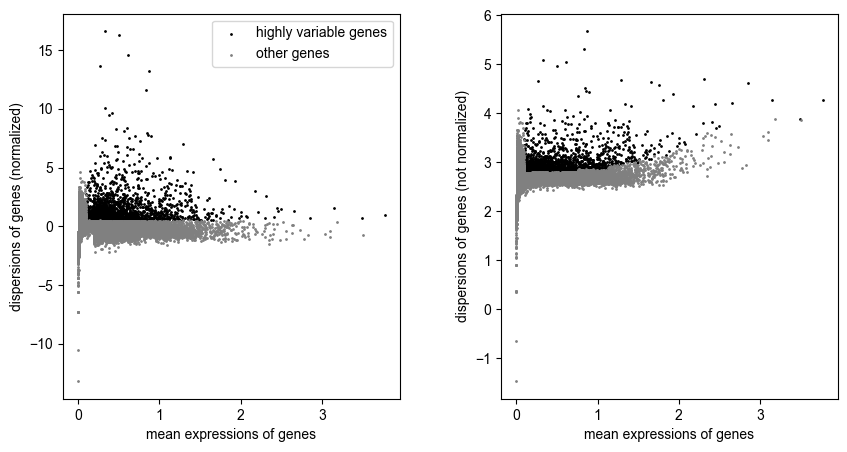

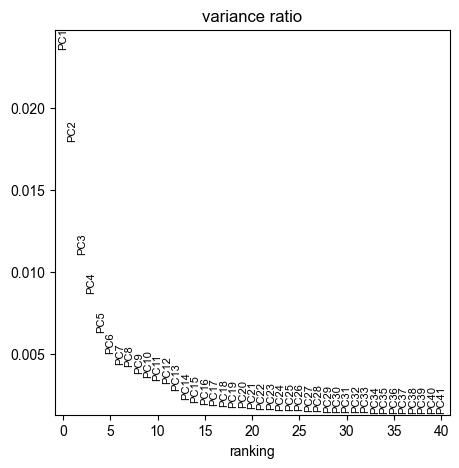

In [45]:
stroma_ad = recluster(stroma_ad, n_pcs=10, n_neighbors=10, key_added='stroma_leiden_tmp', resolution=0.25)

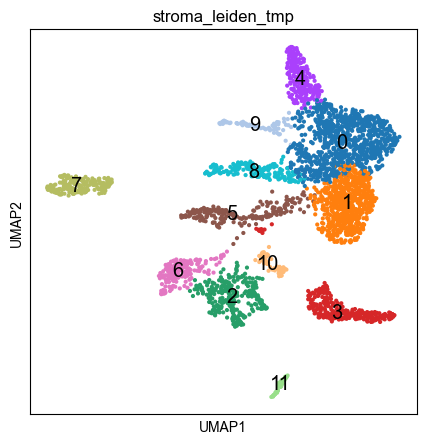

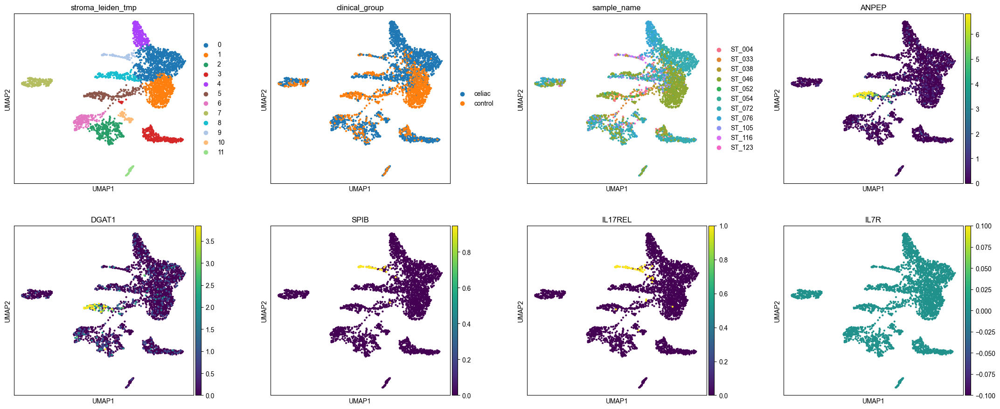

In [46]:
# Plot umap
plt.rcParams["figure.figsize"] = (5, 5)

# Ensure the color list matches the number of clusters
n_leiden = stroma_ad.obs['stroma_leiden_tmp'].nunique()
# stroma_ad.uns['stroma_leiden_colors'] = sns.color_palette("husl", n_colors=n_leiden).as_hex()

sc.pl.umap(stroma_ad, color=["stroma_leiden_tmp",],legend_loc='on data', legend_fontweight='heavy', legend_fontsize='x-large')
sc.pl.umap(stroma_ad, color=["stroma_leiden_tmp",'clinical_group','sample_name',"ANPEP","DGAT1","SPIB","IL17REL","IL7R"],wspace=0.3, vmax='p99', )

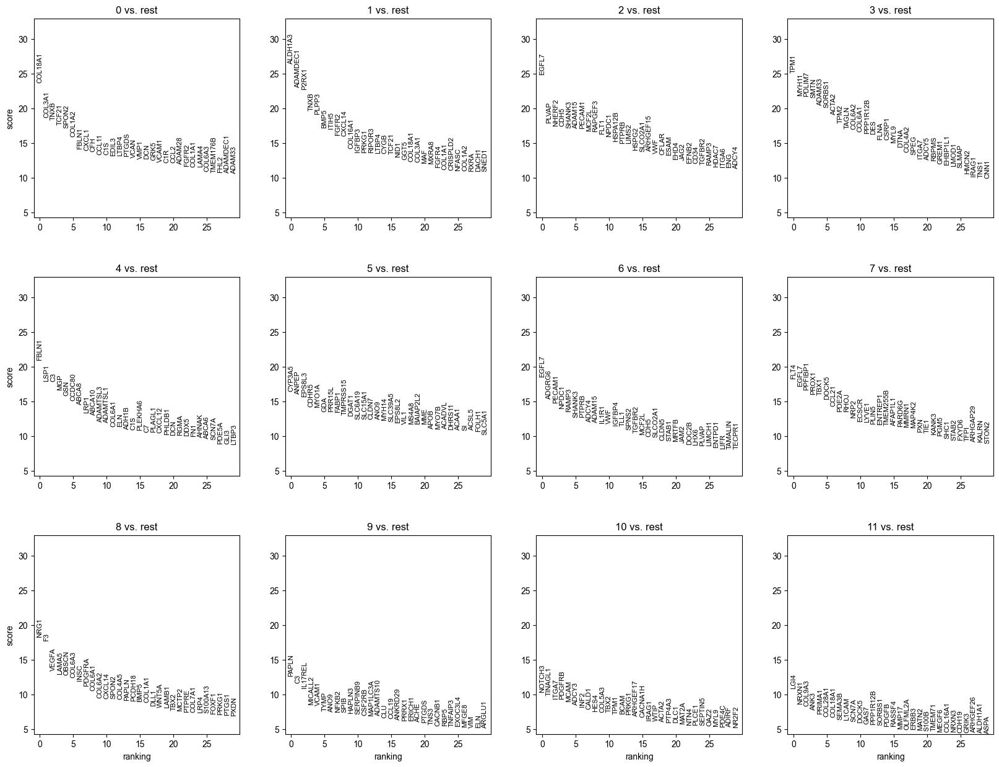

In [47]:
sc.tl.rank_genes_groups(stroma_ad,  groupby='stroma_leiden_tmp',  method='wilcoxon', layer='log_norm')
sc.pl.rank_genes_groups(stroma_ad,  groupby='stroma_leiden_tmp',  n_genes=30)

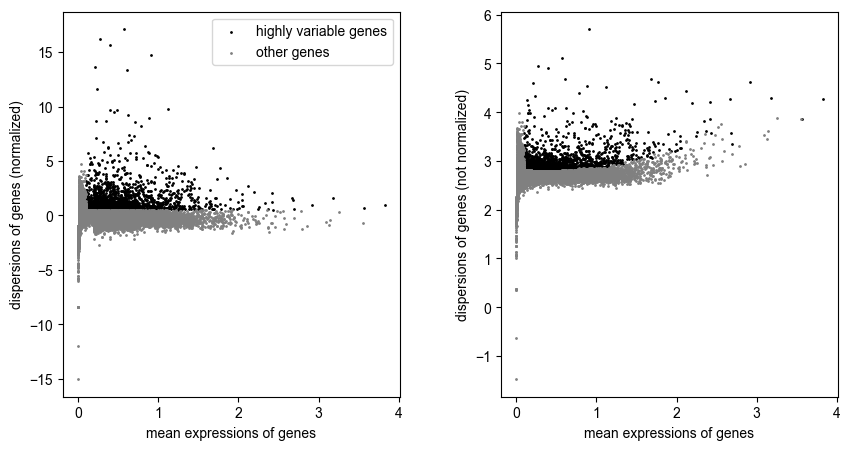

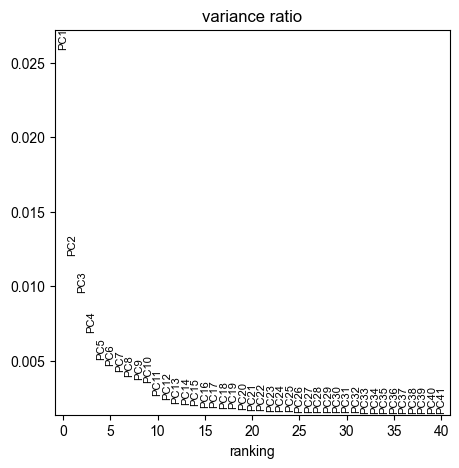

In [48]:
# drop clusters 5/9 (epithelial/immune doublets)
stroma_ad = stroma_ad[~stroma_ad.obs['stroma_leiden_tmp'].isin(['5','9'])].copy()
stroma_ad = recluster(stroma_ad, n_pcs=15, n_neighbors=10, key_added='stroma_leiden', resolution=0.3)

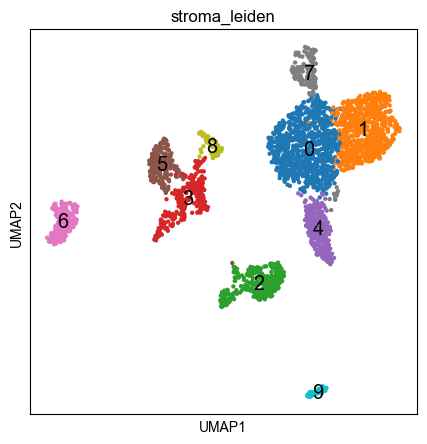

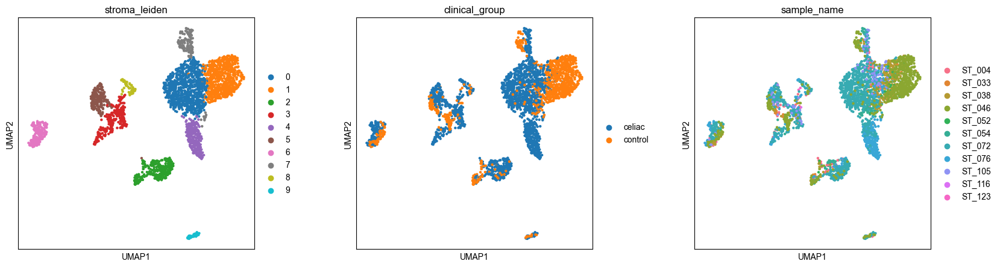

In [49]:
# Plot umap
plt.rcParams["figure.figsize"] = (5, 5)

# Ensure the color list matches the number of clusters
n_leiden = stroma_ad.obs['stroma_leiden'].nunique()
# stroma_ad.uns['stroma_leiden_colors'] = sns.color_palette("husl", n_colors=n_leiden).as_hex()

sc.pl.umap(stroma_ad, color=["stroma_leiden",],legend_loc='on data', legend_fontweight='heavy', legend_fontsize='x-large')
sc.pl.umap(stroma_ad, color=["stroma_leiden",'clinical_group','sample_name'],wspace=0.3, vmax='p99', )

In [50]:
# how many celiac and controls per cluster stroma_leiden
stroma_ct_table = pd.crosstab(stroma_ad.obs['stroma_leiden'], stroma_ad.obs['clinical_group'])
stroma_ct_table

clinical_group,celiac,control
stroma_leiden,,
0,797,83
1,39,651
2,220,64
3,208,72
4,273,1
5,135,56
6,103,72
7,85,55
8,54,12


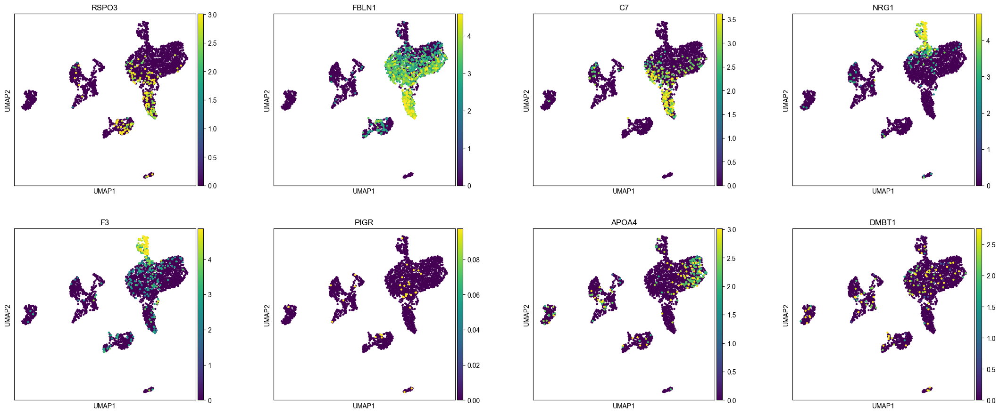

In [51]:
sc.pl.umap(stroma_ad, color=["RSPO3","FBLN1","C7","NRG1","F3","PIGR","APOA4","DMBT1"],wspace=0.3,layer='log_norm', vmax='p99')

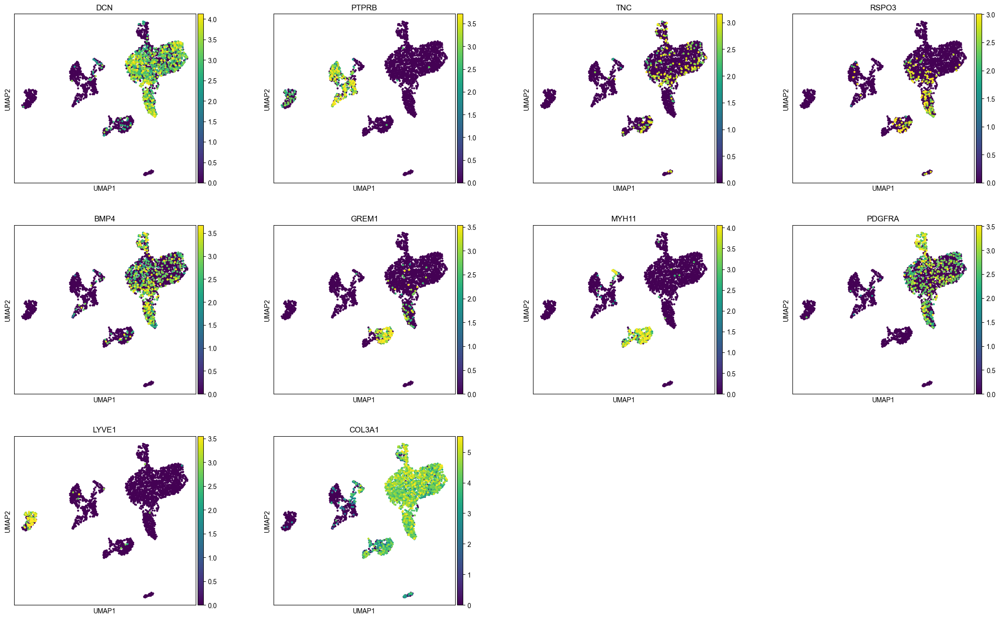

In [52]:
sc.pl.umap(stroma_ad, color=["DCN","PTPRB","TNC","RSPO3","BMP4","GREM1","MYH11","PDGFRA","LYVE1",'COL3A1'],wspace=0.3,layer='log_norm', vmax='p99')

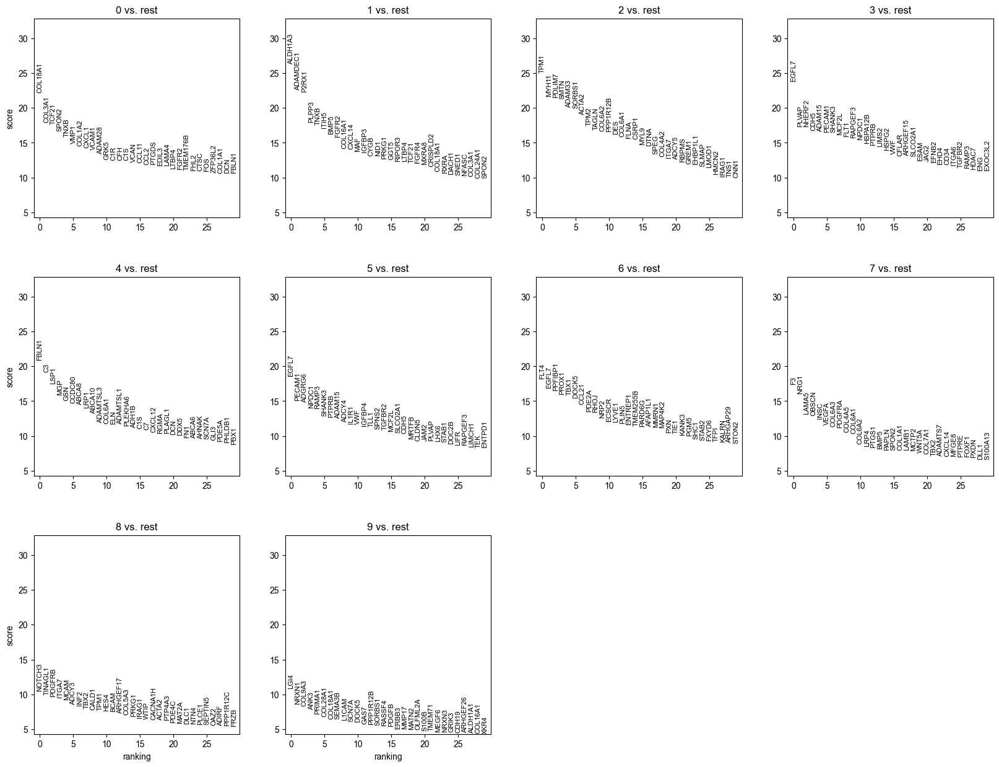

In [53]:
# if SHOW_DGE:
sc.tl.rank_genes_groups(stroma_ad,  groupby='stroma_leiden',  method='wilcoxon', layer='log_norm')
sc.pl.rank_genes_groups(stroma_ad,  groupby='stroma_leiden',  n_genes=30)

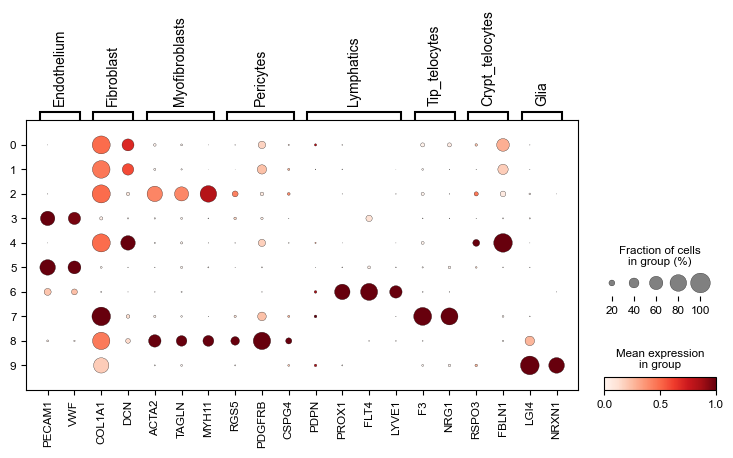

In [54]:
marker_genes = {
    'Endothelium':['PECAM1','VWF'],
    "Fibroblast":["COL1A1","DCN"],
    "Myofibroblasts":["ACTA2","TAGLN","MYH11",],
    "Pericytes":["RGS5","PDGFRB","CSPG4"],
    "Lymphatics":["PDPN","PROX1","FLT4","LYVE1"],
    "Tip_telocytes":["F3","NRG1"],
    "Crypt_telocytes":["RSPO3","FBLN1"],
    "Glia":["LGI4","NRXN1"]
}
sc.pl.dotplot(stroma_ad, marker_genes, groupby="stroma_leiden", standard_scale="var")

In [55]:
stroma_ad.obs['cell_type_lvl2'] = stroma_ad.obs.stroma_leiden.map({
    "0":"Fibroblasts",
    "1":"Fibroblasts",
    "2":"Myofibroblasts",
    "3":"Endothelial_cells",
    "4":"Crypt_telocytes",
    "5":"Endothelial_cells",
    "6":"Lymphatics_cells",
    "7":"Tip_telocytes",
    "8":"Myofibroblasts",
    "9":"Glia",
})

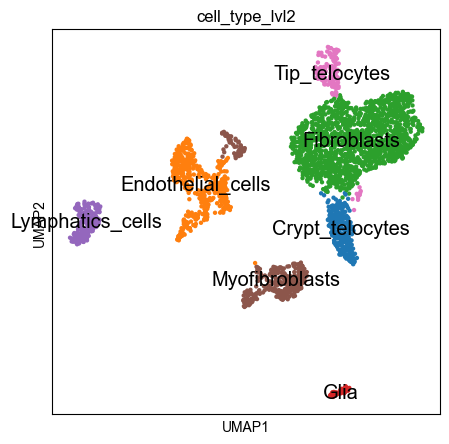

In [56]:
sc.pl.umap(stroma_ad, color=["cell_type_lvl2"], legend_loc='on data', legend_fontweight='heavy', legend_fontsize='x-large')

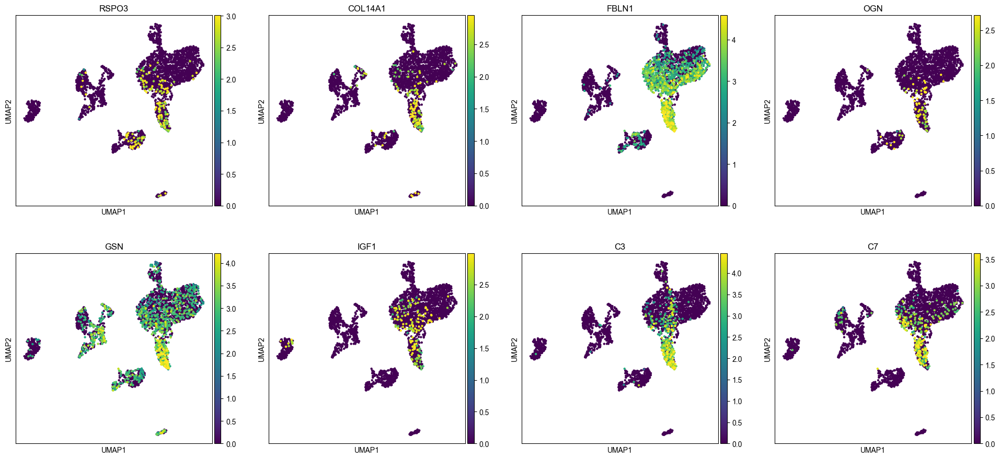

In [57]:
sc.pl.umap(stroma_ad, color=["RSPO3","COL14A1","FBLN1","OGN","GSN","IGF1","C3","C7"], legend_loc='on data', legend_fontweight='heavy', legend_fontsize='x-large', vmax='p99', layer='log_norm')

In [58]:
adata.obs['cell_type_lvl2'] = adata.obs['cell_type_lvl2'].astype(str)
# adata.obs['cell_type_lvl3'] = adata.obs['cell_type_lvl3'].astype(str)

# update adata with cell_type_lvl2 from stroma_ad
adata.obs.loc[stroma_ad.obs_names, 'cell_type_lvl2'] = stroma_ad.obs['cell_type_lvl2'].astype(str)
# adata.obs.loc[stroma_ad.obs_names, 'cell_type_lvl3'] = stroma_ad.obs['cell_type_lvl2'].astype(str)

# copy coordinates of stroma_ad
adata.obs[['stroma_umap1','stroma_umap2']] = np.nan
adata.obs.loc[stroma_ad.obs_names, ['stroma_umap1','stroma_umap2']] = stroma_ad.obsm['X_umap']

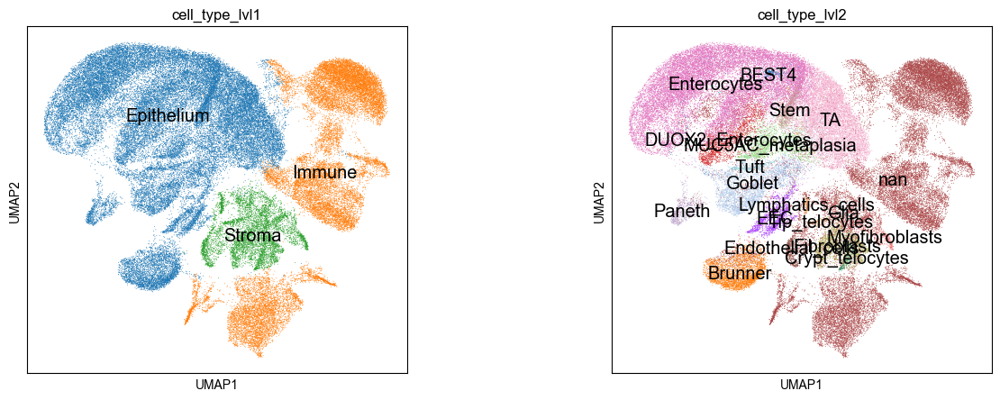

In [59]:
sc.pl.umap(adata, color=['cell_type_lvl1','cell_type_lvl2'], wspace=0.4, ncols=2, legend_loc='on data', legend_fontweight='heavy', legend_fontsize='x-large')

### Immune

In [60]:
immune_ad = adata[adata.obs['cell_type_lvl1']=="Immune"].copy()

exp_filter_thresh = 1e-4
for gene in ["PIGR","DGAT1","APOA4","PTPRB","MUC6","COL1A1","PECAM1","DMBT1"]:
    immune_ad = filter_gene(immune_ad, gene, exp_filter_thresh)

immune_ad

Number of cells before PIGR filtering: 23932
Number of cells after PIGR filtering: 16788
Number of cells removed: 7144
Number of cells before DGAT1 filtering: 16788
Number of cells after DGAT1 filtering: 14594
Number of cells removed: 2194
Number of cells before APOA4 filtering: 14594
Number of cells after APOA4 filtering: 13422
Number of cells removed: 1172
Number of cells before PTPRB filtering: 13422
Number of cells after PTPRB filtering: 13397
Number of cells removed: 25
Number of cells before MUC6 filtering: 13397
Number of cells after MUC6 filtering: 11919
Number of cells removed: 1478
Number of cells before COL1A1 filtering: 11919
Number of cells after COL1A1 filtering: 11565
Number of cells removed: 354
Number of cells before PECAM1 filtering: 11565
Number of cells after PECAM1 filtering: 10060
Number of cells removed: 1505
Number of cells before DMBT1 filtering: 10060
Number of cells after DMBT1 filtering: 9598
Number of cells removed: 462


AnnData object with n_obs × n_vars = 9598 × 18129
    obs: 'sample_name', 'batch', 'clinical_group', 'processing_method', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'log10_total_counts', 'leiden', 'cell_type_lvl1', 'cell_type_lvl2', 'epi_umap1', 'epi_umap2', 'entero_umap1', 'entero_umap2', 'stroma_umap1', 'stroma_umap2'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts-0', 'mean_counts-0', 'log1p_mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'log1p_total_counts-0', 'n_cells_by_counts-1', 'mean_counts-1', 'log1p_mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'log1p_total_counts-1', 'n_cells_by_counts-10', 'mean_counts-10', 'log1p_mean_counts-10', 'pct_dropout_by_counts-10', 'total_counts-10', 'log1p_total_counts-

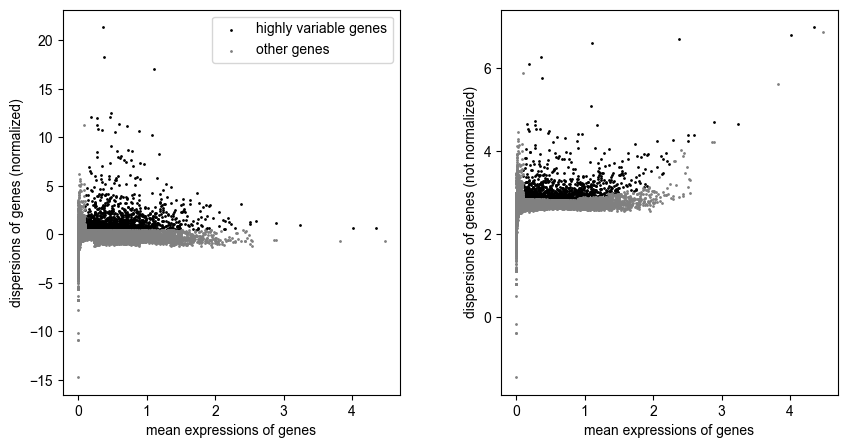

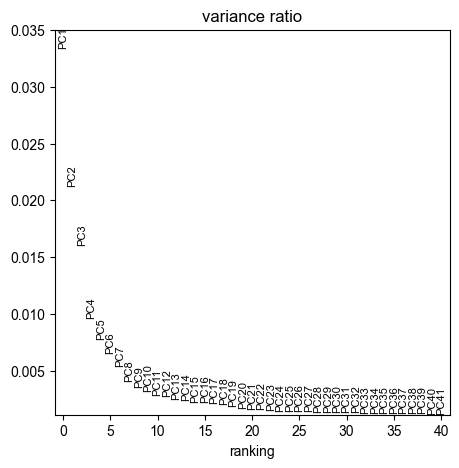

In [61]:
immune_ad = recluster(immune_ad, n_pcs=10, n_neighbors=10, key_added='immune_leiden_tmp', resolution=1)

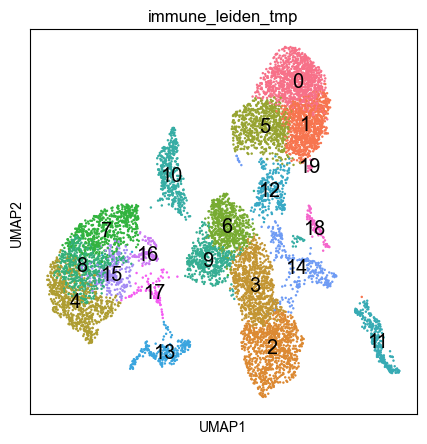

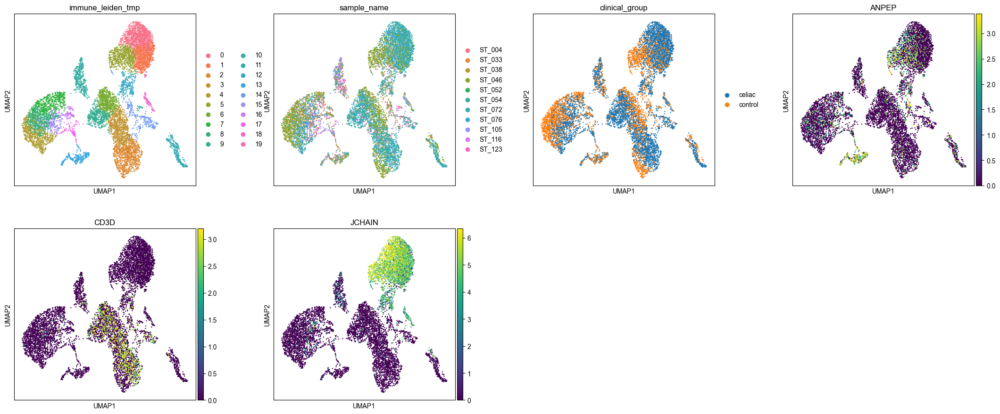

In [62]:
# Plot umap
plt.rcParams["figure.figsize"] = (5, 5)

# Ensure the color list matches the number of clusters
n_leiden = immune_ad.obs['immune_leiden_tmp'].nunique()
immune_ad.uns['immune_leiden_tmp_colors'] = sns.color_palette("husl", n_colors=n_leiden).as_hex()

sc.pl.umap(immune_ad, color=["immune_leiden_tmp",],legend_loc='on data', legend_fontweight='heavy', legend_fontsize='x-large')
sc.pl.umap(immune_ad, color=["immune_leiden_tmp",'sample_name','clinical_group',"ANPEP",'CD3D',"JCHAIN"],wspace=0.3,vmax='p99',layer='log_norm' )

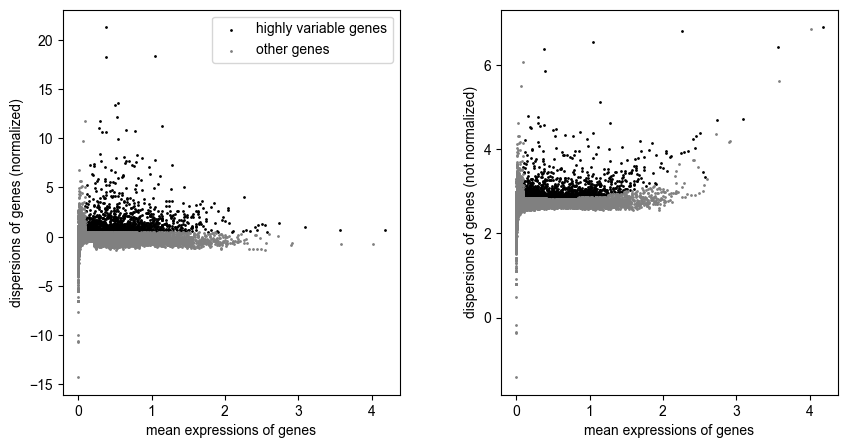

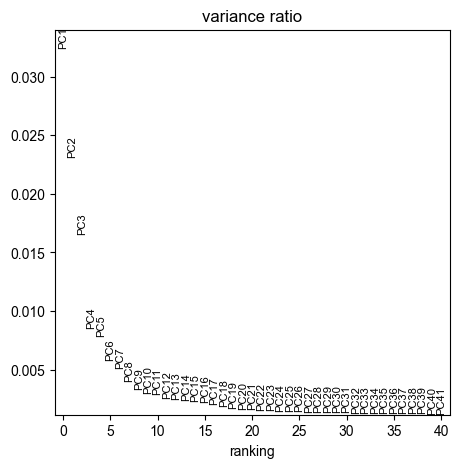

In [63]:
# drop clusters 5/12/13 (epithelial and immune doublets)
immune_ad = immune_ad[~immune_ad.obs['immune_leiden_tmp'].isin(['5','12','13'])].copy()
immune_ad = recluster(immune_ad, n_pcs=15, n_neighbors=10, key_added='immune_leiden', resolution=0.25)

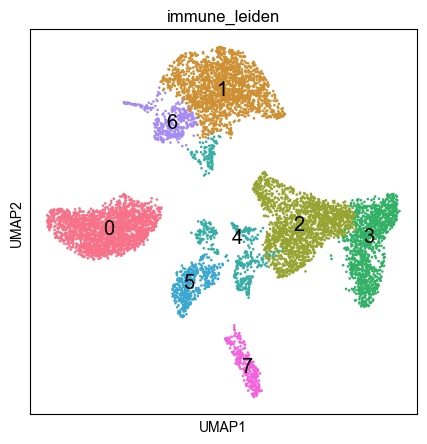

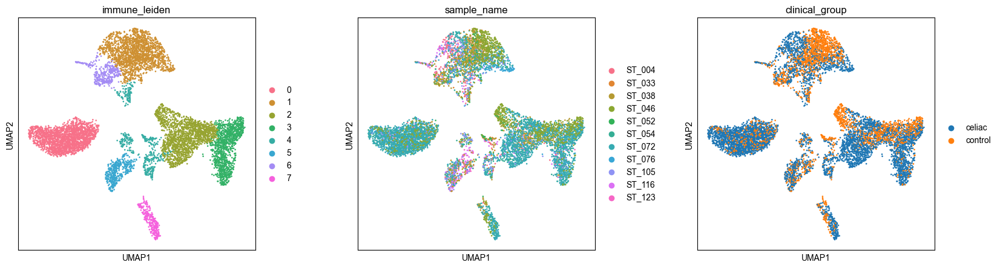

In [64]:
# Plot umap
plt.rcParams["figure.figsize"] = (5, 5)

# Ensure the color list matches the number of clusters
n_leiden = immune_ad.obs['immune_leiden'].nunique()
immune_ad.uns['immune_leiden_colors'] = sns.color_palette("husl", n_colors=n_leiden).as_hex()

sc.pl.umap(immune_ad, color=["immune_leiden",],legend_loc='on data', legend_fontweight='heavy', legend_fontsize='x-large')
sc.pl.umap(immune_ad, color=["immune_leiden",'sample_name','clinical_group'],wspace=0.3)

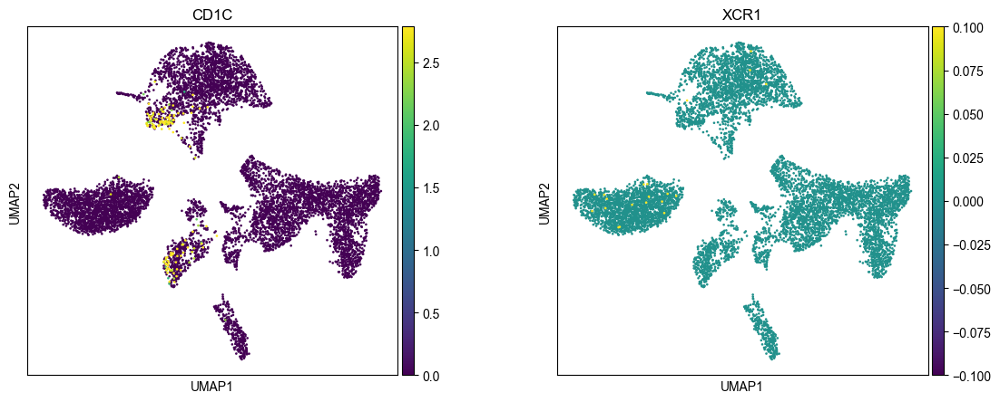

In [65]:
sc.pl.umap(immune_ad, color=["CD1C","XCR1"],wspace=0.3,layer='log_norm', vmax='p99')

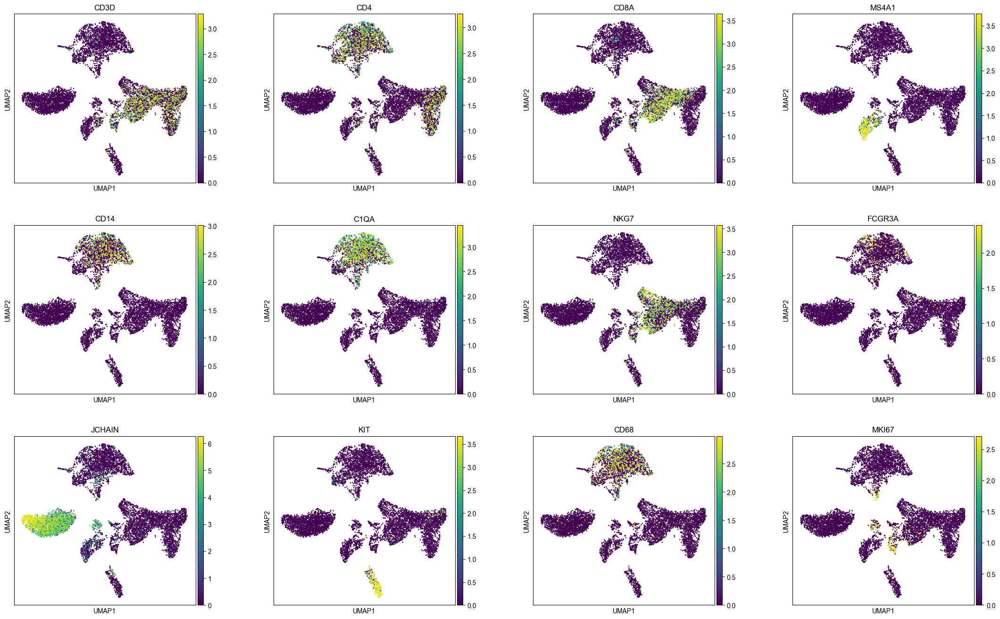

In [66]:
sc.pl.umap(immune_ad, color=["CD3D","CD4","CD8A","MS4A1","CD14","C1QA","NKG7","FCGR3A","JCHAIN","KIT","CD68","MKI67"],wspace=0.3,layer='log_norm', vmax='p99')

In [67]:
immune_ad.obs['cell_type_lvl2'] = immune_ad.obs.immune_leiden.map({
    "0":"Plasma",#
    "1":"Myeloid",#
    "2":"NKT",#
    "3":"NKT",#
    "4":"Proliferation",#
    "5":"B_cells",#
    "6":"DC",#
    "7":"Mast",#
})
# immune_ad.obs['cell_type_lvl3'] = immune_ad.obs['cell_type_lvl2']

In [68]:
if SHOW_DGE:
    sc.tl.rank_genes_groups(immune_ad,  groupby='immune_leiden',  method='wilcoxon', layer='log_norm')
    sc.pl.rank_genes_groups(immune_ad,  groupby='immune_leiden',  n_genes=30)

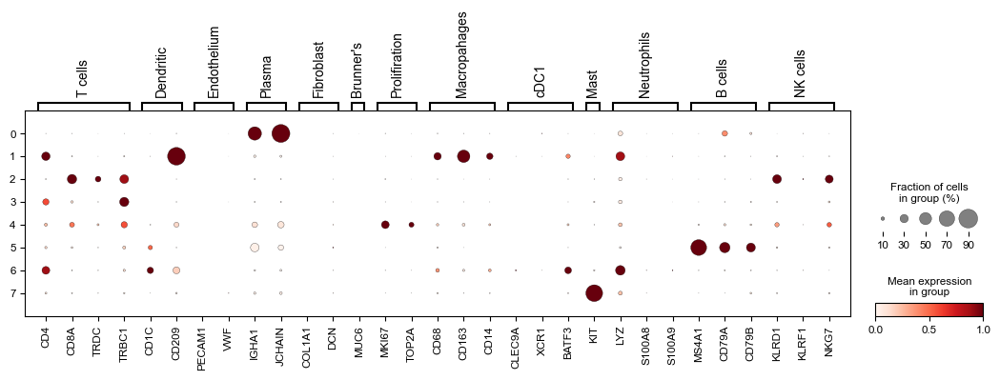

In [69]:
marker_genes = {
    "T cells":["CD4","CD8A","TRDC","TRBC1"],
    "Dendritic":["CD1C","CLEC9A","CD209"],
    'Endothelium':['PECAM1','VWF'],
    "Plasma":["IGHA1","JCHAIN"],
    "Fibroblast":["COL1A1","DCN"],
    "Brunner's":["MUC6"],
    "Prolifiration":["MKI67","TOP2A",],
    "Macropahages":["CD68","CD163","CD14"],
    "Dendritic":["CD1C","CD209",],
    "cDC1":["CLEC9A","XCR1","BATF3"],
    "Mast":["KIT"],
    "Neutrophils":["LYZ","S100A8","S100A9"],
    "B cells":["MS4A1","CD79A","CD79B"],
    "NK cells":["KLRD1","KLRF1","NKG7"],
}
sc.pl.dotplot(immune_ad, marker_genes, groupby="immune_leiden", standard_scale="var")

In [70]:
adata.obs['cell_type_lvl2'] = adata.obs['cell_type_lvl2'].astype(str)
# adata.obs['cell_type_lvl3'] = adata.obs['cell_type_lvl3'].astype(str)

# update adata with cell_type_lvl2 from immune_ad
adata.obs.loc[immune_ad.obs_names, 'cell_type_lvl2'] = immune_ad.obs['cell_type_lvl2']
# adata.obs.loc[immune_ad.obs_names, 'cell_type_lvl3'] = immune_ad.obs['cell_type_lvl3']

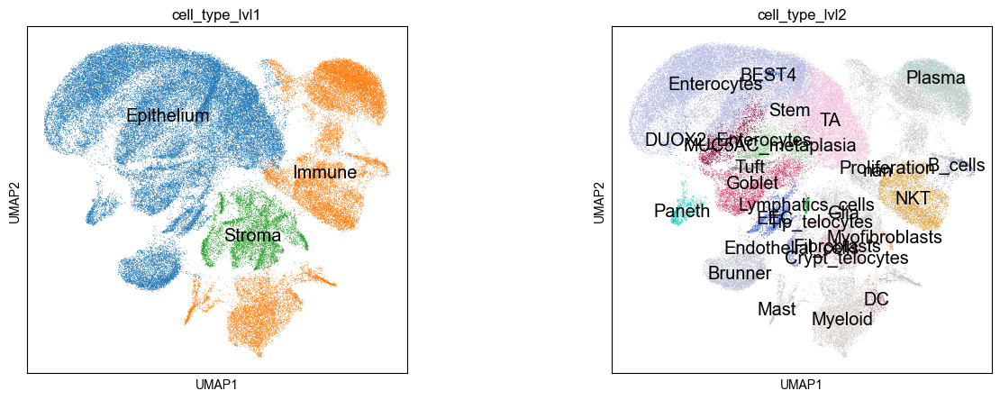

In [71]:
sc.pl.umap(adata, color=['cell_type_lvl1','cell_type_lvl2'], wspace=0.4, ncols=2, legend_loc='on data', legend_fontweight='heavy', legend_fontsize='x-large')

In [72]:
# adata.obs['cell_type_lvl2'] = adata.obs['cell_type_lvl2'].fillna(adata.obs['cell_type_lvl1'])
# adata.obs['cell_type_lvl3'] = adata.obs['cell_type_lvl3'].fillna(adata.obs['cell_type_lvl2'])

### Transfer to general adata

In [73]:
# add epi_leiden and stroma_leiden to adata
adata.obs['epi_leiden'] = np.nan
adata.obs['stroma_leiden'] = np.nan
# adata.obs['eec_leiden'] = np.nan
adata.obs['imm_leiden'] = np.nan
adata.obs.loc[immune_ad.obs_names, 'imm_leiden'] = immune_ad.obs['immune_leiden']
adata.obs.loc[epi_ad.obs_names, 'epi_leiden'] = epi_ad.obs['epi_leiden']
adata.obs.loc[stroma_ad.obs_names, 'stroma_leiden'] = stroma_ad.obs['stroma_leiden']
# adata.obs.loc[eec_ad.obs_names, 'eec_leiden'] = eec_ad.obs['eec_leiden']

In [74]:
stroma_ad.obs[['umap_1','umap_2']] = stroma_ad.obsm['X_umap']
# eec_ad.obs[['umap_1','umap_2']] = eec_ad.obsm['X_umap']
# entero_ad.obs[['umap_1','umap_2']] = entero_ad.obsm['X_umap']
immune_ad.obs[['umap_1','umap_2']] = immune_ad.obsm['X_umap']

adata.obs.loc[stroma_ad.obs_names, ['stroma_umap_1','stroma_umap_2']] = stroma_ad.obsm['X_umap']
# adata.obs.loc[eec_ad.obs_names, ['eec_umap_1','eec_umap_2']] = eec_ad.obsm['X_umap']
# adata.obs.loc[entero_ad.obs_names, ['entero_umap_1','entero_umap_2']] = entero_ad.obsm['X_umap']
adata.obs.loc[immune_ad.obs_names, ['immune_umap_1','immune_umap_2']] = immune_ad.obsm['X_umap']

In [75]:
# adata.obs['cell_type_lvl2'] = adata.obs.cell_type_lvl1.astype(str)
# adata.obs.loc[stroma_ad.obs_names, 'cell_type_lvl2'] = stroma_ad.obs['cell_type_lvl2']
# adata.obs.loc[epi_ad.obs_names, 'cell_type_lvl2'] = epi_ad.obs['cell_type_lvl2']
# adata.obs['cell_type_lvl3'] = adata.obs.cell_type_lvl2.astype(str)
# adata.obs.loc[epi_ad.obs_names, 'cell_type_lvl3'] = epi_ad.obs['cell_type_lvl3']
# adata.obs.loc[eec_ad.obs_names, 'cell_type_lvl3'] = eec_ad.obs['cell_type_lvl3']

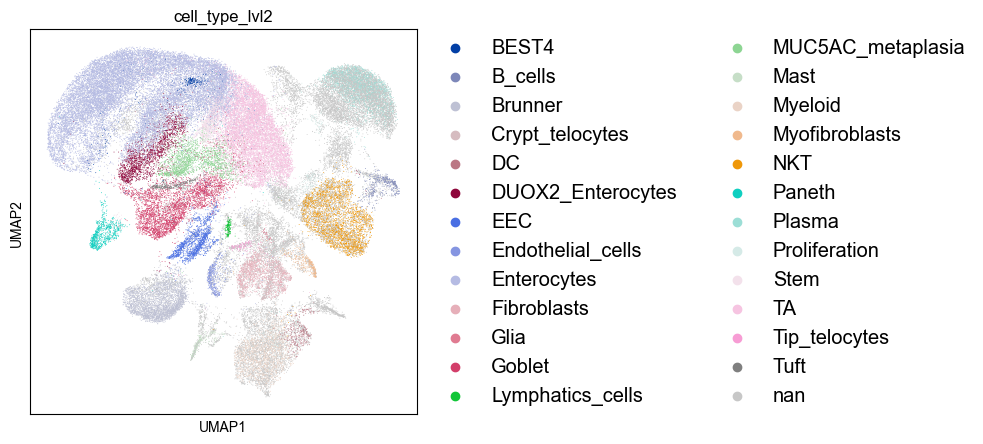

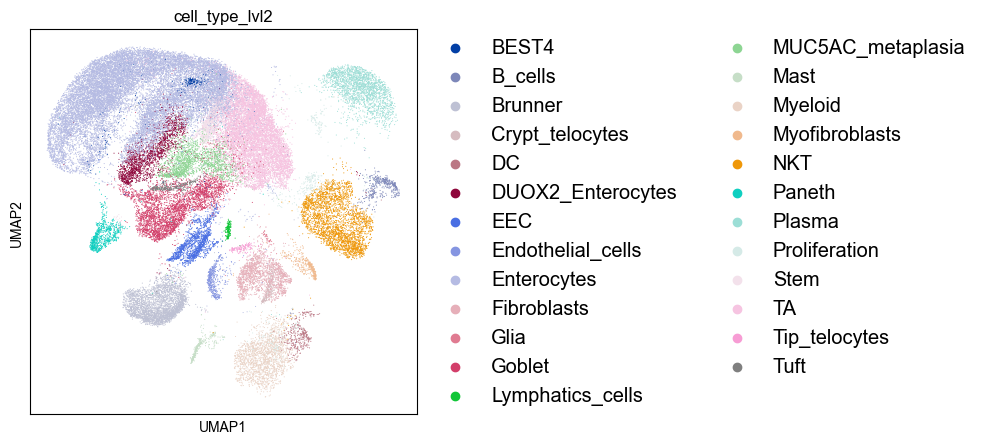

In [76]:
sc.pl.umap(adata, color=["cell_type_lvl2"], legend_fontweight='heavy', legend_fontsize='x-large')
sc.pl.umap(adata[adata.obs['cell_type_lvl2'] != "nan"], color=["cell_type_lvl2"], legend_fontweight='heavy', legend_fontsize='x-large')

Remove all the cells without cell type lvl2 annotation

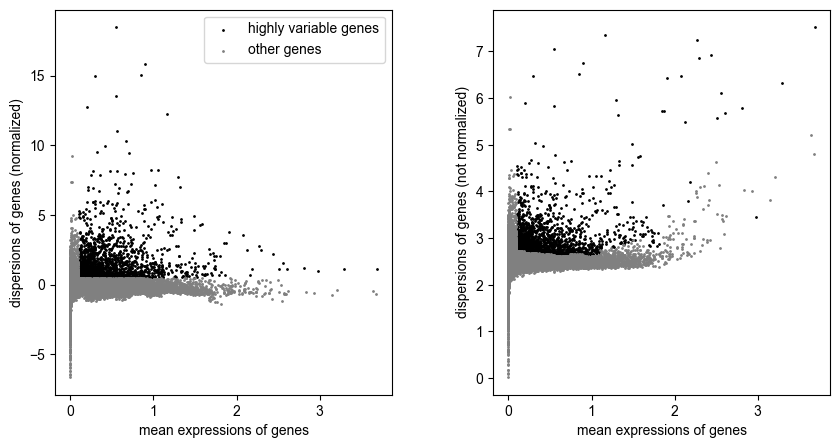

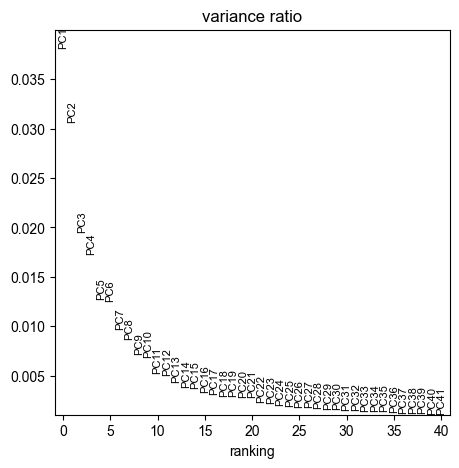

In [77]:
adata = adata[adata.obs['cell_type_lvl2'] != 'nan'].copy()
adata = recluster(adata, n_pcs=15, n_neighbors=10)

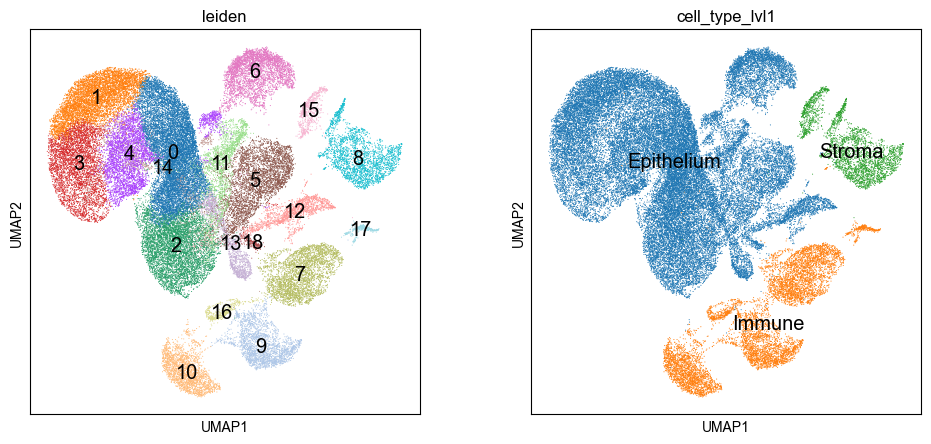

In [78]:
sc.pl.umap(adata, color=["leiden",'cell_type_lvl1'],legend_loc='on data', legend_fontweight='heavy', legend_fontsize='x-large')

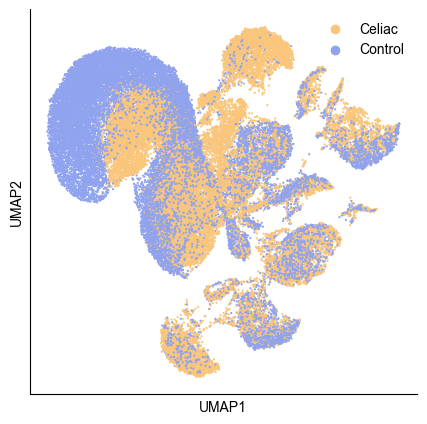

In [79]:
diagnosis_palette = [ "#fac67c","#8fa3ee"]  # Control: blue, CeD: orange
fig, ax = plt.subplots(figsize=(5,5))
sc.pl.umap(adata, color=['clinical_group'], palette=diagnosis_palette, size=10, alpha=1, ax=ax, show=False, legend_loc='best')

# make legend text capitalize
handles, labels = ax.get_legend_handles_labels()
labels = [label.capitalize() for label in labels]
ax.legend(handles, labels, frameon=False)

plt.title("")
sns.despine()
plt.show()

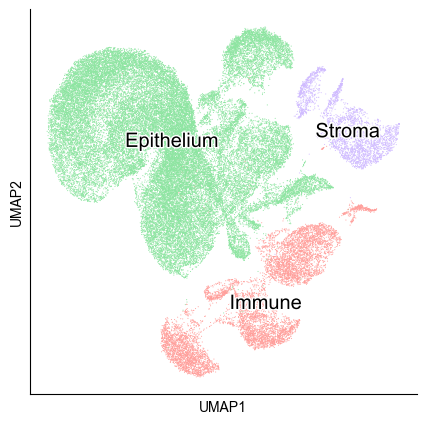

In [80]:
# Define a dictionary mapping cell types to specific colors
cell_type_palette = {
    "Epithelium": sns.color_palette("pastel")[2],  # Example color
    "Immune": sns.color_palette("pastel")[3],      # Example color
    "Stroma": sns.color_palette("pastel")[4],      # Example color
    "Plasma": "#FFC300",      # Example color
    "Fibroblasts": "#DAF7A6", # Example color
    "Endothelial_cells": "#C70039", # Example color
    "Myofibroblasts": "#900C3F",    # Example color
    "Lymphatics_cells": "#581845",  # Example color
    "Tip_telocytes": "#1ABC9C",     # Example color
    "Crypt_telocytes": "#3498DB",   # Example color
    "Glia": "#9B59B6",              # Example color
}

# Use the palette in your UMAP plot
fig, ax = plt.subplots(figsize=(5, 5))
sc.pl.umap(adata, color=['cell_type_lvl1'], palette=cell_type_palette, 
           ncols=2, legend_loc='on data', legend_fontweight='heavy', legend_fontsize='x-large', ax=ax, show=False)
for text in ax.texts:
    text.set_path_effects([withStroke(linewidth=2, foreground='white')])
    text.set_text(text.get_text().capitalize())
plt.title("")
sns.despine()
plt.show()

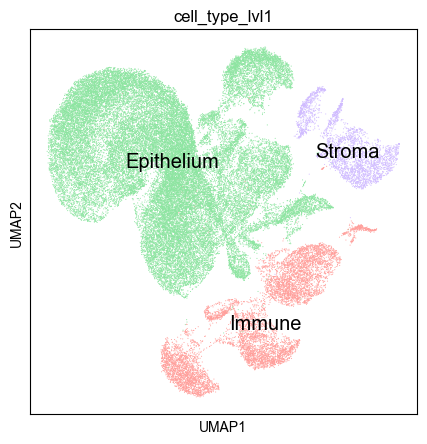

In [81]:
sc.pl.umap(adata, color=['cell_type_lvl1'],legend_loc='on data', legend_fontweight='heavy', legend_fontsize='x-large')

In [82]:
adata.obs.cell_type_lvl2.value_counts()

cell_type_lvl2
Enterocytes          18827
TA                    8789
Goblet                3551
Brunner               3247
NKT                   2881
Plasma                2105
Myeloid               1816
MUC5AC_metaplasia     1787
DUOX2_Enterocytes     1721
Fibroblasts           1570
EEC                   1444
Stem                  1055
Paneth                 736
Endothelial_cells      471
Proliferation          468
B_cells                436
BEST4                  382
DC                     363
Myofibroblasts         350
Tuft                   336
Mast                   300
Crypt_telocytes        274
Lymphatics_cells       175
Tip_telocytes          140
Glia                    46
Name: count, dtype: int64

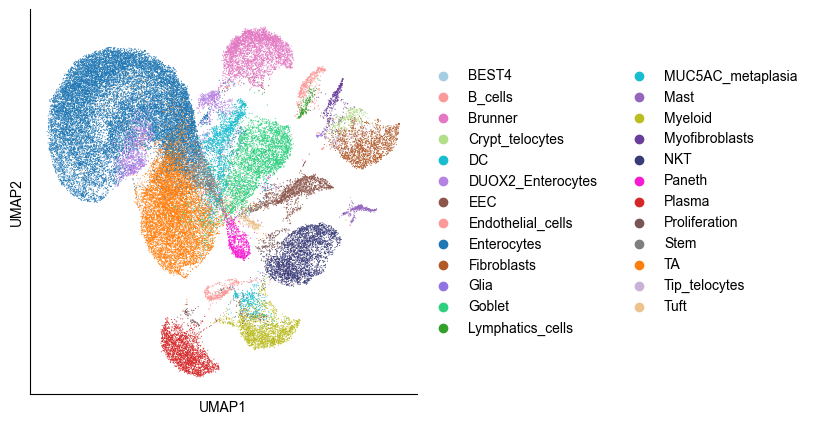

In [83]:
# Define a dictionary mapping cell types to specific colors
cell_type_palette = {
    "Enterocytes": "#1f77b4",#
    "TA": "#ff7f0e",#
    "Plasma": "#d62728",#
    "B_cells": "#fb9a99",#
    "Goblet": "#2ED07F",#
    "EEC": "#8c564b",#
    "Brunner": "#e377c2",#
    "Stem": "#7f7f7f",#
    "Paneth": "#f819d3",#
    "Myeloid": "#bcbd22",
    "DC": "#17becf",#
    "NKT": "#393b79",#
    "Mast": "#9467bd",#
    "Proliferation": "#7A5555",#
    "MUC5AC_metaplasia": "#17becf",#
    "DUOX2_Enterocytes": "#b582e4",#
    "BEST4":"#a6cee3",#
    "Crypt_telocytes":"#b2df8a",#
    "Fibroblasts":"#b15928",#
    "Myofibroblasts":"#6a3d9a",#
    "Tip_telocytes":"#cab2d6",#
    "Endothelial_cells":"#fb9a99",#
    "Lymphatics_cells":"#33a02c",#
    "Tuft":"#ecc38d",#
    "Glia":"#9373E4",#
}

fig, ax = plt.subplots(figsize=(5, 5))
sc.pl.umap(adata, color=['cell_type_lvl2'], palette=cell_type_palette, ax=ax, show=False)
# Add white outline to text
for text in ax.texts:
    text.set_path_effects([withStroke(linewidth=2, foreground='white')])

plt.title("")
sns.despine()
plt.show()

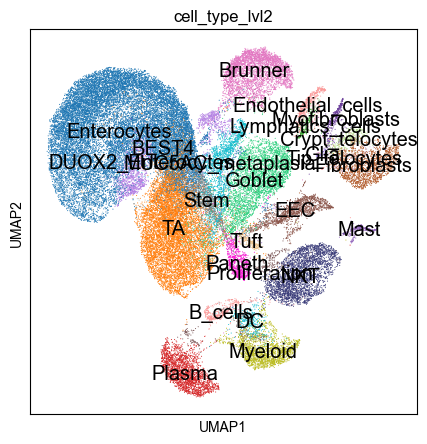

In [84]:
sc.pl.umap(adata, color=['cell_type_lvl2'],legend_loc='on data', legend_fontweight='heavy', legend_fontsize='x-large')

In [85]:
# save data with doublets for yael
# dill.dump(adata, open("flex_adata_processed_with_doublets_bg_substracted.pkl", "wb"))

In [86]:
# # drop celltypes with lvl2 that contains "doublet"
# print("Number of cells before removing Doublets and Enterocytes:", adata.n_obs)
# adata = adata[~adata.obs['cell_type_lvl2'].str.contains("doublet", case=False)].copy()
# adata = adata[~adata.obs['cell_type_lvl3'].astype(str).str.contains("doublet", case=False)].copy()
# print("Number of cells after removing Doublets and Enterocytes:", adata.n_obs)

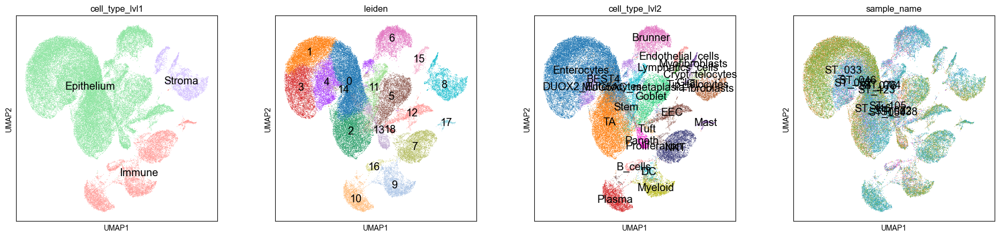

In [87]:
sc.pl.umap(adata, color=["cell_type_lvl1",'leiden',"cell_type_lvl2","sample_name"], legend_loc='on data', legend_fontweight='heavy', legend_fontsize='x-large')

In [88]:
levels = adata.obs.columns[adata.obs.columns.str.startswith('cell_type_lvl')]
# create signature table for cell_type_lvl1
for my_level in levels:
    print(my_level)
    signature_table_lvl = pd.DataFrame(index=adata.var_names)
    for cell_type in adata.obs[my_level].unique():
        cells = adata[adata.obs[my_level] == cell_type]
        mean_expression = np.mean(cells.layers['mat_norm'], axis=0).A1
        signature_table_lvl[cell_type] = mean_expression
    signature_table_lvl.to_csv(f"flex_signature_table_{my_level}_bg_substracted.csv")

cell_type_lvl1
cell_type_lvl2


In [89]:
print(datetime.now())

2026-01-14 12:07:53.073696


## Export

In [90]:
adata.write_h5ad("/mnt/d/celiac_files/10x_flex_all_samples_processed_bg.h5ad")

In [91]:
adata.write_h5ad("10x_flex_all_samples_processed_bg.h5ad")

Export specific to CSV

In [ ]:
# adata.to_df().to_csv("flex_counts_bg.csv")

In [ ]:
# adata.obs[['umap_1', 'umap_2']] = adata.obsm['X_umap']
# adata.obs.to_csv("flex_obs_bg.csv")

In [94]:
print(datetime.now())

2026-01-14 12:34:13.903135


In [ ]:
print(session_info2.session_info(dependencies=True))

pandas	2.3.1
anndata	0.12.0
scanpy	1.11.3
seaborn	0.13.2
matplotlib	3.10.3
numpy	2.2.6
plotly	6.2.0
adjustText	1.3.0
tqdm	4.67.1
gseapy	1.1.9
scipy	1.15.3
scikit-learn	1.7.1
statsmodels	0.14.5
dill	0.4.0
----	----
sphinxcontrib-jsmath	1.0.1
igraph	0.11.9
zarr	2.18.7
texttable	1.7.0
patsy	1.0.1
executing	2.2.0
narwhals	1.47.1
wrapt	1.17.2
parso	0.8.4
pytz	2025.2
six	1.17.0
urllib3	2.5.0
sphinxcontrib-applehelp	2.0.0
python-dateutil	2.9.0.post0
dask	2024.11.2
Pygments	2.19.2
typing_extensions	4.14.1
pure_eval	0.2.3
pillow	11.3.0
zipp	3.23.0
sphinxcontrib-qthelp	2.0.0
natsort	8.4.0
cloudpickle	3.1.1
idna	3.10
requests	2.32.4
asttokens	3.0.0
pyparsing	3.2.3
Jinja2	3.1.6
jedi	0.19.2
pynndescent	0.5.13
psutil	7.0.0
packaging	25.0
et_xmlfile	2.0.0
comm	0.2.2
matplotlib-inline	0.1.7
tornado	6.5.1
prompt_toolkit	3.0.51
h5py	3.14.0
ipython	9.4.0
numcodecs	0.15.1
numba	0.61.2
charset-normalizer	3.4.2
openpyxl	3.1.5
asciitree	0.3.3
pyzmq	27.0.0
PyYAML	6.0.2
xarray	2025.9.0
decorator	5.2.1
sphinxco

: 